<div class="alert alert-block alert-info">
<center> <h1> BUSINESS CASE 2 - BUSINESS CASES FOR DATA SCIENCE </h1> </center> <br>
<center> MDSAA 2021/2022 </center>

**Table of Contents** <br>
* [1) Imports](#imports)
    * [1.1) Import Libraries](#importlibraries)
    * [1.2) Import Dataset](#importdataset)
* [2) Data Exploration](#dataexploration)
    * [2.1) Descriptive Statistics](#descriptivestatistics)
    * [2.2) Check Duplicates and Missing Values](#checkdupandmv)
    * [2.3) Check Data Types](#checkdatatypes)
    * [2.4) Visual Exploration](#visualexploration)
    * [2.5) Coherence Checking](#coherencechecking)
* [3) Data Preparation](#datapreparation)
    * [3.1) Outliers](#outliers)
* [4) Data Pre-processing](#datapreprocessing)
    * [4.1) Feature Engineering ](#featureengineering)
    * [4.2) Feature Selection](#featureselection)
    * [4.3) Scaling](#scaling)
    * [4.4) Dimensionality Reduction - PCA](#pca)
* [5) Modelling](#modelling)

<a class="anchor" id="import">

## 1. Import

</a>

<a class="anchor" id="importlibraries">

__`1.1. Import Libraries`__ 
    
</a>

In [1]:
import pandas as pd
import math
import numpy as np

from sklearn.cluster import KMeans
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler

from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import TimeSeriesSplit

from sklearn.metrics import f1_score, classification_report, confusion_matrix
from sklearn import metrics

import seaborn as sns

import matplotlib.pyplot as plt

import scipy.stats as stats

import plotly.express as px

<a class="anchor" id="importdataset">

__`1.2. Import Dataset`__ 
    
</a>

In [3]:
#bookings = pd.read_csv(r'C:\Users\Administrador\OneDrive - NOVAIMS\Mestrado\Business Cases DS\business-cases-21-22\BC2_predicting_cancellations\H2.csv')
bookings = pd.read_csv("H2.csv")

bookings.head()

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
0,0,6,2015,July,27,1,0,2,1,0.0,...,No Deposit,6,NULL,0,Transient,0.0,0,0,Check-Out,2015-07-03
1,1,88,2015,July,27,1,0,4,2,0.0,...,No Deposit,9,NULL,0,Transient,76.5,0,1,Canceled,2015-07-01
2,1,65,2015,July,27,1,0,4,1,0.0,...,No Deposit,9,NULL,0,Transient,68.0,0,1,Canceled,2015-04-30
3,1,92,2015,July,27,1,2,4,2,0.0,...,No Deposit,9,NULL,0,Transient,76.5,0,2,Canceled,2015-06-23
4,1,100,2015,July,27,2,0,2,2,0.0,...,No Deposit,9,NULL,0,Transient,76.5,0,1,Canceled,2015-04-02


<a class="anchor" id="dataexploration">

## 2. Data Exploration

</a>

<a class="anchor" id="descriptivestatistics">

__`2.1. Descriptive Statistics`__ 
    
</a>

In [4]:
bookings.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
IsCanceled,79330.0,NaN,NaN,NaN,0.41727,0.493111,0.0,0.0,0.0,1.0,1.0
LeadTime,79330.0,NaN,NaN,NaN,109.735724,110.948526,0.0,23.0,74.0,163.0,629.0
ArrivalDateYear,79330.0,NaN,NaN,NaN,2016.174285,0.699181,2015.0,2016.0,2016.0,2017.0,2017.0
ArrivalDateMonth,79330,12,August,8983,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ArrivalDateWeekNumber,79330.0,NaN,NaN,NaN,27.177449,13.398523,1.0,17.0,27.0,38.0,53.0
ArrivalDateDayOfMonth,79330.0,NaN,NaN,NaN,15.786625,8.728451,1.0,8.0,16.0,23.0,31.0
StaysInWeekendNights,79330.0,NaN,NaN,NaN,0.795185,0.885026,0.0,0.0,1.0,2.0,16.0
StaysInWeekNights,79330.0,NaN,NaN,NaN,2.182957,1.456416,0.0,1.0,2.0,3.0,41.0
Adults,79330.0,NaN,NaN,NaN,1.850977,0.509292,0.0,2.0,2.0,2.0,4.0
Children,79326.0,NaN,NaN,NaN,0.09137,0.372177,0.0,0.0,0.0,0.0,3.0


<a class="anchor" id="checkdupandmv">

__`2.2. Check Duplicates and Missing Values`__ 
    
</a>

In [5]:
bookings[bookings.duplicated()]

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
9,1,62,2015,July,27,2,2,3,2,0.0,...,No Deposit,8,NULL,0,Transient,76.50,0,1,No-Show,2015-07-02
12,0,43,2015,July,27,3,0,2,2,0.0,...,No Deposit,1,NULL,0,Transient-Party,86.00,0,0,Check-Out,2015-07-05
17,0,43,2015,July,27,3,0,2,2,0.0,...,No Deposit,1,NULL,0,Transient-Party,86.00,0,0,Check-Out,2015-07-05
18,0,43,2015,July,27,3,0,2,2,0.0,...,No Deposit,1,NULL,0,Transient-Party,86.00,0,0,Check-Out,2015-07-05
22,0,43,2015,July,27,3,0,2,2,0.0,...,No Deposit,1,NULL,0,Transient-Party,86.00,0,0,Check-Out,2015-07-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79289,0,186,2017,August,35,31,0,3,2,0.0,...,No Deposit,9,NULL,0,Transient,126.00,0,2,Check-Out,2017-09-03
79292,0,63,2017,August,35,31,0,3,3,0.0,...,No Deposit,9,NULL,0,Transient-Party,195.33,0,2,Check-Out,2017-09-03
79293,0,63,2017,August,35,31,0,3,3,0.0,...,No Deposit,9,NULL,0,Transient-Party,195.33,0,2,Check-Out,2017-09-03
79294,0,63,2017,August,35,31,0,3,3,0.0,...,No Deposit,9,NULL,0,Transient-Party,195.33,0,2,Check-Out,2017-09-03


25 902 duplicates in total were found. 

In [6]:
bookings.drop_duplicates(inplace = True)

In [7]:
bookings.isna().sum()

IsCanceled                     0
LeadTime                       0
ArrivalDateYear                0
ArrivalDateMonth               0
ArrivalDateWeekNumber          0
ArrivalDateDayOfMonth          0
StaysInWeekendNights           0
StaysInWeekNights              0
Adults                         0
Children                       4
Babies                         0
Meal                           0
Country                        6
MarketSegment                  0
DistributionChannel            0
IsRepeatedGuest                0
PreviousCancellations          0
PreviousBookingsNotCanceled    0
ReservedRoomType               0
AssignedRoomType               0
BookingChanges                 0
DepositType                    0
Agent                          0
Company                        0
DaysInWaitingList              0
CustomerType                   0
ADR                            0
RequiredCarParkingSpaces       0
TotalOfSpecialRequests         0
ReservationStatus              0
Reservatio

In [8]:
bookings.dropna(inplace = True)

In [9]:
bookings.isna().sum()

IsCanceled                     0
LeadTime                       0
ArrivalDateYear                0
ArrivalDateMonth               0
ArrivalDateWeekNumber          0
ArrivalDateDayOfMonth          0
StaysInWeekendNights           0
StaysInWeekNights              0
Adults                         0
Children                       0
Babies                         0
Meal                           0
Country                        0
MarketSegment                  0
DistributionChannel            0
IsRepeatedGuest                0
PreviousCancellations          0
PreviousBookingsNotCanceled    0
ReservedRoomType               0
AssignedRoomType               0
BookingChanges                 0
DepositType                    0
Agent                          0
Company                        0
DaysInWaitingList              0
CustomerType                   0
ADR                            0
RequiredCarParkingSpaces       0
TotalOfSpecialRequests         0
ReservationStatus              0
Reservatio

In [10]:
bookings.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
IsCanceled,53418.0,NaN,NaN,NaN,0.300292,0.458389,0.0,0.0,0.0,1.0,1.0
LeadTime,53418.0,NaN,NaN,NaN,77.689131,82.113652,0.0,14.0,50.0,118.0,629.0
ArrivalDateYear,53418.0,NaN,NaN,NaN,2016.254109,0.659209,2015.0,2016.0,2016.0,2017.0,2017.0
ArrivalDateMonth,53418,12,August,6587,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ArrivalDateWeekNumber,53418.0,NaN,NaN,NaN,26.635516,13.585946,1.0,16.0,27.0,37.0,53.0
ArrivalDateDayOfMonth,53418.0,NaN,NaN,NaN,15.756056,8.801769,1.0,8.0,16.0,23.0,31.0
StaysInWeekendNights,53418.0,NaN,NaN,NaN,0.87214,0.913676,0.0,0.0,1.0,2.0,16.0
StaysInWeekNights,53418.0,NaN,NaN,NaN,2.274364,1.618204,0.0,1.0,2.0,3.0,41.0
Adults,53418.0,NaN,NaN,NaN,1.876427,0.544125,0.0,2.0,2.0,2.0,4.0
Children,53418.0,NaN,NaN,NaN,0.131866,0.442199,0.0,0.0,0.0,0.0,3.0


By comparing this describe table with the previous one, we can see that **25 912** observations were removed, leaving us **53 418** to work with.

<a class="anchor" id="checkdatatypes">

__`2.3. Check Data Types`__ 
    
</a>

In [11]:
bookings.dtypes

IsCanceled                       int64
LeadTime                         int64
ArrivalDateYear                  int64
ArrivalDateMonth                object
ArrivalDateWeekNumber            int64
ArrivalDateDayOfMonth            int64
StaysInWeekendNights             int64
StaysInWeekNights                int64
Adults                           int64
Children                       float64
Babies                           int64
Meal                            object
Country                         object
MarketSegment                   object
DistributionChannel             object
IsRepeatedGuest                  int64
PreviousCancellations            int64
PreviousBookingsNotCanceled      int64
ReservedRoomType                object
AssignedRoomType                object
BookingChanges                   int64
DepositType                     object
Agent                           object
Company                         object
DaysInWaitingList                int64
CustomerType             

In [12]:
# Changing the data type of Children to int 
bookings.Children = bookings.Children.astype('int') 

In [13]:
bookings.dtypes

IsCanceled                       int64
LeadTime                         int64
ArrivalDateYear                  int64
ArrivalDateMonth                object
ArrivalDateWeekNumber            int64
ArrivalDateDayOfMonth            int64
StaysInWeekendNights             int64
StaysInWeekNights                int64
Adults                           int64
Children                         int32
Babies                           int64
Meal                            object
Country                         object
MarketSegment                   object
DistributionChannel             object
IsRepeatedGuest                  int64
PreviousCancellations            int64
PreviousBookingsNotCanceled      int64
ReservedRoomType                object
AssignedRoomType                object
BookingChanges                   int64
DepositType                     object
Agent                           object
Company                         object
DaysInWaitingList                int64
CustomerType             

<a class="anchor" id="visualexploration">

__`2.4. Visual Exploration`__ 
    
</a>

Text(0, 0.5, 'Count')

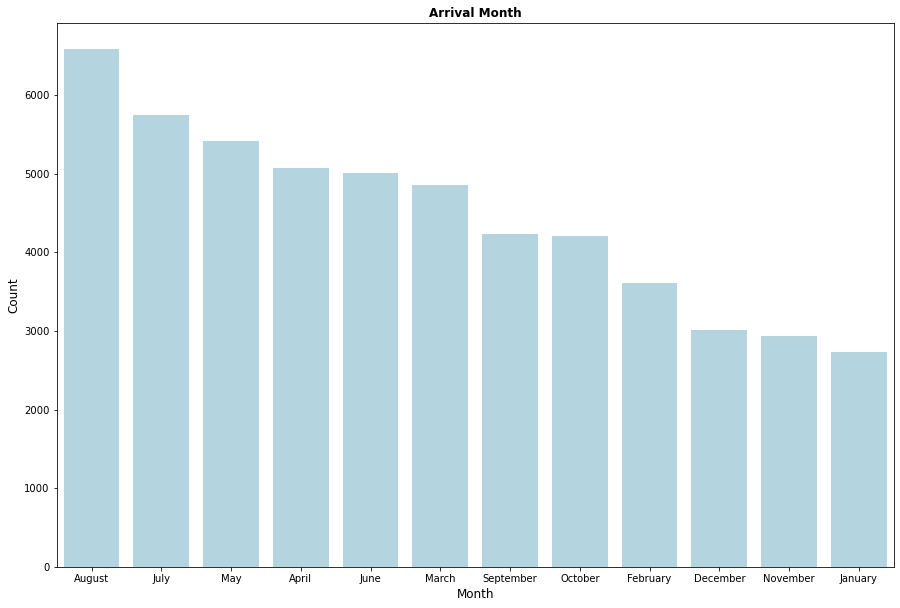

In [14]:
# Display arrival count by month 
plt.figure(figsize=(15,10))
sns.countplot(x='ArrivalDateMonth', data = bookings,
              order=pd.value_counts(bookings['ArrivalDateMonth']).index, color='lightblue')
plt.title('Arrival Month', weight='bold')
plt.xlabel('Month', fontsize=12)
plt.ylabel('Count', fontsize=12)

Displaying arrival count by month allows us to see which months bring more clisents to the hotel. 


In [14]:
# Display relationship between StaysInWeekendNights & StaysInWeekNights columns
pd.crosstab(index = bookings['StaysInWeekNights'],columns=bookings['StaysInWeekendNights'], margins=True, margins_name = 'Total').iloc[:10]

StaysInWeekendNights,0,1,2,3,4,5,6,7,8,9,10,13,14,16,Total
StaysInWeekNights,,,,,,,,,,,,,,,
0,286,2406,1102,0,0,0,0,0,0,0,0,0,0,0,3794
1,7877,3134,3460,0,0,0,0,0,0,0,0,0,0,0,14471
2,6586,4493,3708,0,0,0,0,0,0,0,0,0,0,0,14787
3,5597,3408,2563,0,0,0,0,0,0,0,0,0,0,0,11568
4,2503,1222,1139,0,0,0,0,0,0,0,0,0,0,0,4864
5,395,506,1850,113,25,0,0,0,0,0,0,0,0,0,2889
6,0,0,253,63,43,0,0,0,0,0,0,0,0,0,359
7,0,0,111,59,23,0,0,0,0,0,0,0,0,0,193
8,0,0,89,34,32,0,0,0,0,0,0,0,0,0,155


In [15]:
# Create new feature: 'Weekend/Weekday' 
pd.options.mode.chained_assignment = None
def weekendOrWeekday(feature1, feature2, data_source):
    data_source['Weekend/Weekday'] = 0
    for i in range(0, len(data_source)):
        if feature2.iloc[i] == 0 and feature1.iloc[i] > 0:
            bookings['Weekend/Weekday'].iloc[i] = 'WeekendOnly'
        if feature2.iloc[i] > 0 and feature1.iloc[i] == 0:
            bookings['Weekend/Weekday'].iloc[i] = 'WeekdaydOnly'
        if feature2.iloc[i] > 0 and feature1.iloc[i] > 0:
            bookings['Weekend/Weekday'].iloc[i] = 'Both'
        if feature2.iloc[i] == 0 and feature1.iloc[i] == 0:
            bookings['Weekend/Weekday'].iloc[i] = 'NoHistory'

            
weekendOrWeekday(bookings['StaysInWeekendNights'],bookings['StaysInWeekNights'], bookings)

Text(0, 0.5, 'Bookings')

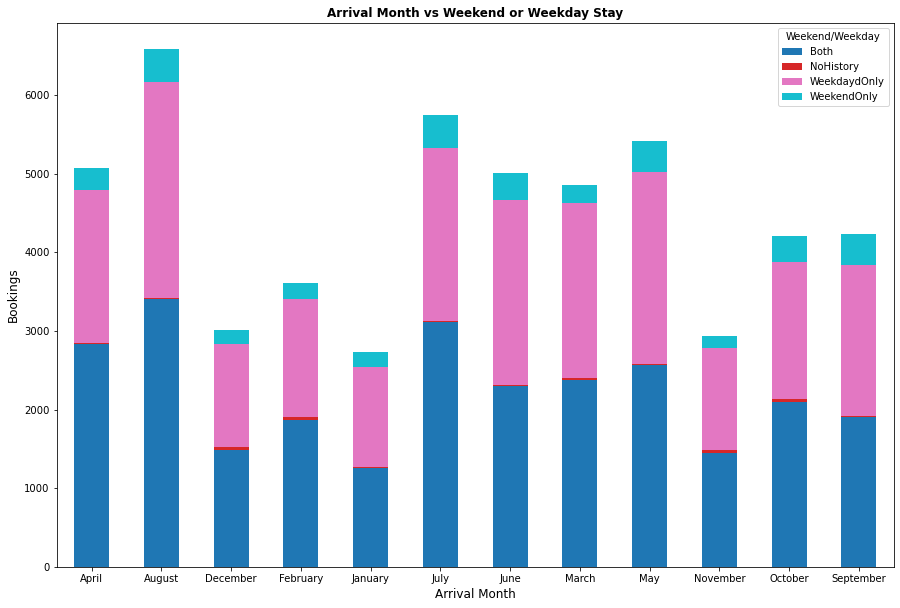

In [16]:
# Graph `ArrivalDateMonth` vs `Weekend/Weekday` 
groupData = bookings.groupby([ 'ArrivalDateMonth','Weekend/Weekday']).size().unstack(fill_value=0)
groupData.sort_values('ArrivalDateMonth', ascending = True).plot(kind='bar',stacked=True, cmap='tab10',figsize=(15,10))
plt.title('Arrival Month vs Weekend or Weekday Stay', weight='bold')
plt.xlabel('Arrival Month', fontsize=12)
plt.xticks(rotation=360)
plt.ylabel('Bookings', fontsize=12)

This chart allows us to understand, not only the most booked months, as well as differentiate between the type of stays. 

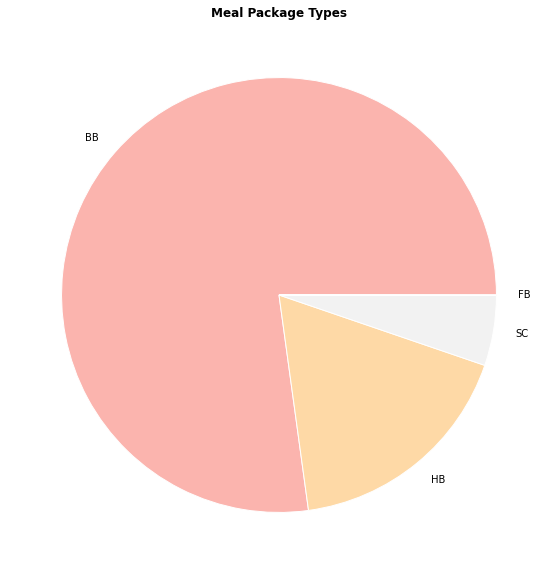

In [17]:
# Visualizing `meal` column data
mealLabels= ['BB','HB', 'SC', 'FB']
size = bookings['Meal'].value_counts()
plt.figure(figsize=(10,10))
cmap =plt.get_cmap("Pastel1")
colors = cmap(np.arange(3)*4)
plt.pie(size, labels=mealLabels, colors=colors, wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white' })
p=plt.gcf()
plt.title('Meal Package Types', weight='bold')
plt.show()

This chart (above) lets us know which type of meal is more frequently chosen by the clients upon reservation. 
The one below shows how many meal per time were associated to the reservations.

Text(0, 0.5, 'Count')

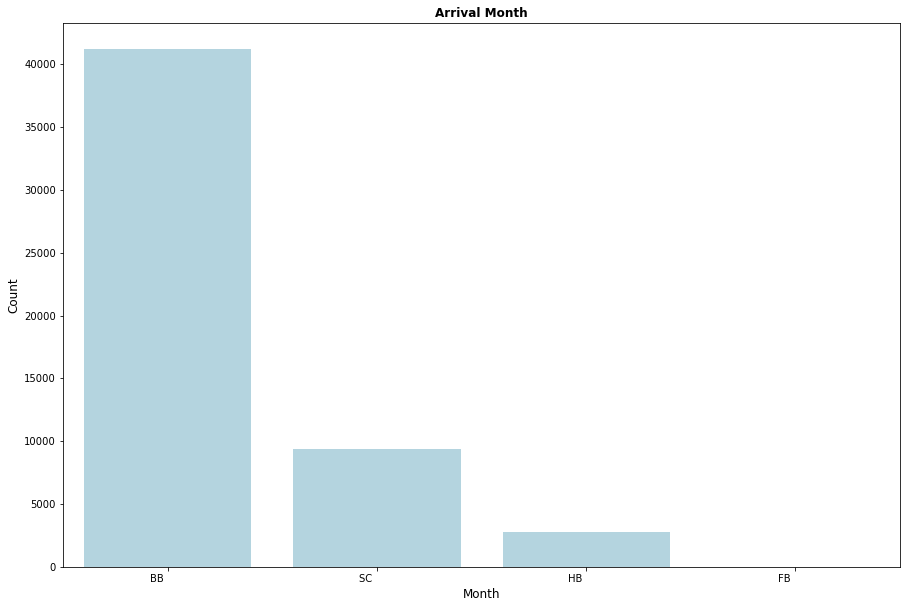

In [18]:
# Display count of meal type
plt.figure(figsize=(15,10))
sns.countplot(x='Meal', data = bookings,
              order=pd.value_counts(bookings['Meal']).index, color='lightblue')
plt.title('Arrival Month', weight='bold')
plt.xlabel('Month', fontsize=12)
plt.ylabel('Count', fontsize=12)

Text(0, 0.5, 'Bookings')

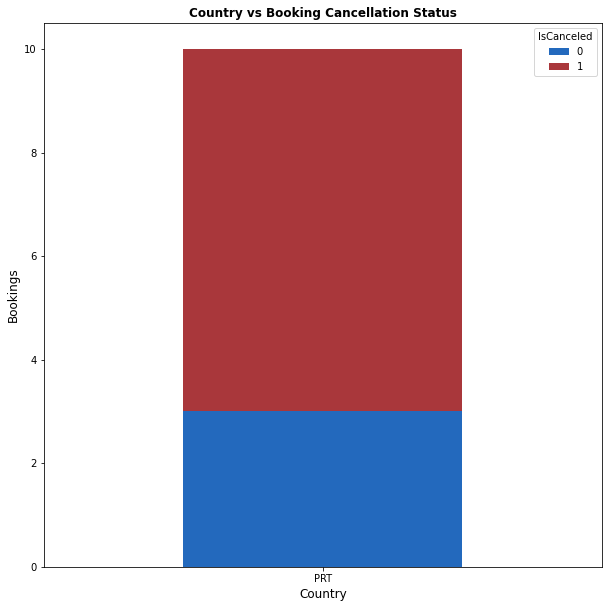

In [19]:
# Use groupby to see if number of special requests affects cancellation status
groupSpecRequest = bookings.groupby([bookings['Country'].iloc[:10], 'IsCanceled']).size().unstack(fill_value=0)
groupSpecRequest.plot(kind='bar', stacked=True, cmap='vlag', figsize=(10,10))
plt.title('Country vs Booking Cancellation Status', weight='bold')
plt.xlabel('Country', fontsize=12)
plt.xticks(rotation=360)
plt.ylabel('Bookings', fontsize=12)

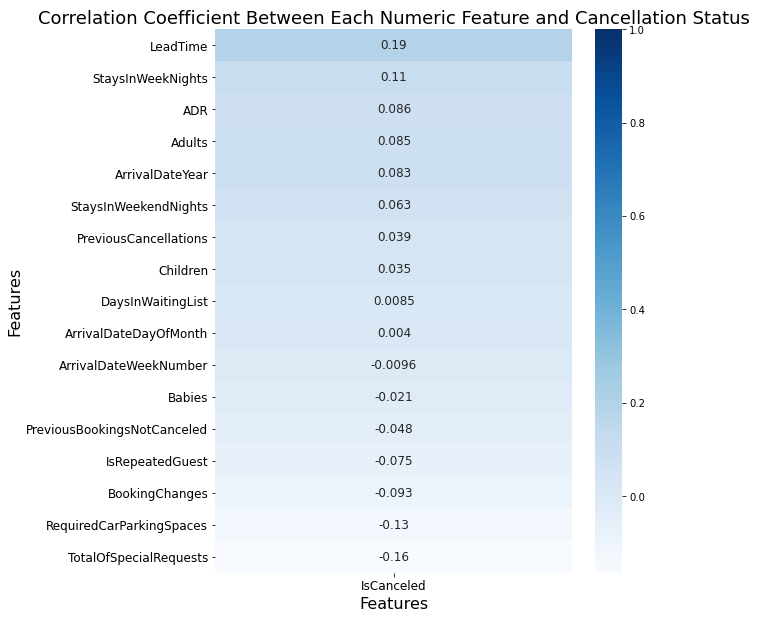

In [21]:
# Visualizing correlation coefficients between features and cancellation:
fig = plt.figure(figsize=(8,10))
ax = sns.heatmap(bookings.corr()[['IsCanceled']].sort_values('IsCanceled', ascending=False), annot = True, annot_kws = {"size":12}, cmap='Blues')
ax.set_title('Correlation Coefficient Between Each Numeric Feature and Cancellation Status', fontsize=18)
ax.set_xlabel('Features', fontsize = 16)
ax.set_ylabel('Features', fontsize = 16)
ax.tick_params(axis = "both", labelsize = 12);
y_min, y_max = ax.get_ylim()
ax.set_ylim(top=y_max+1);

In [10]:
sns.set_style("ticks")
sns.pairplot(bookings, hue = 'IsCanceled', diag_kind = "hist", kind = "scatter", palette = "Paired", corner = True)
plt.show()

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x000002AD63CF0EE0> (for post_execute):


KeyboardInterrupt: 

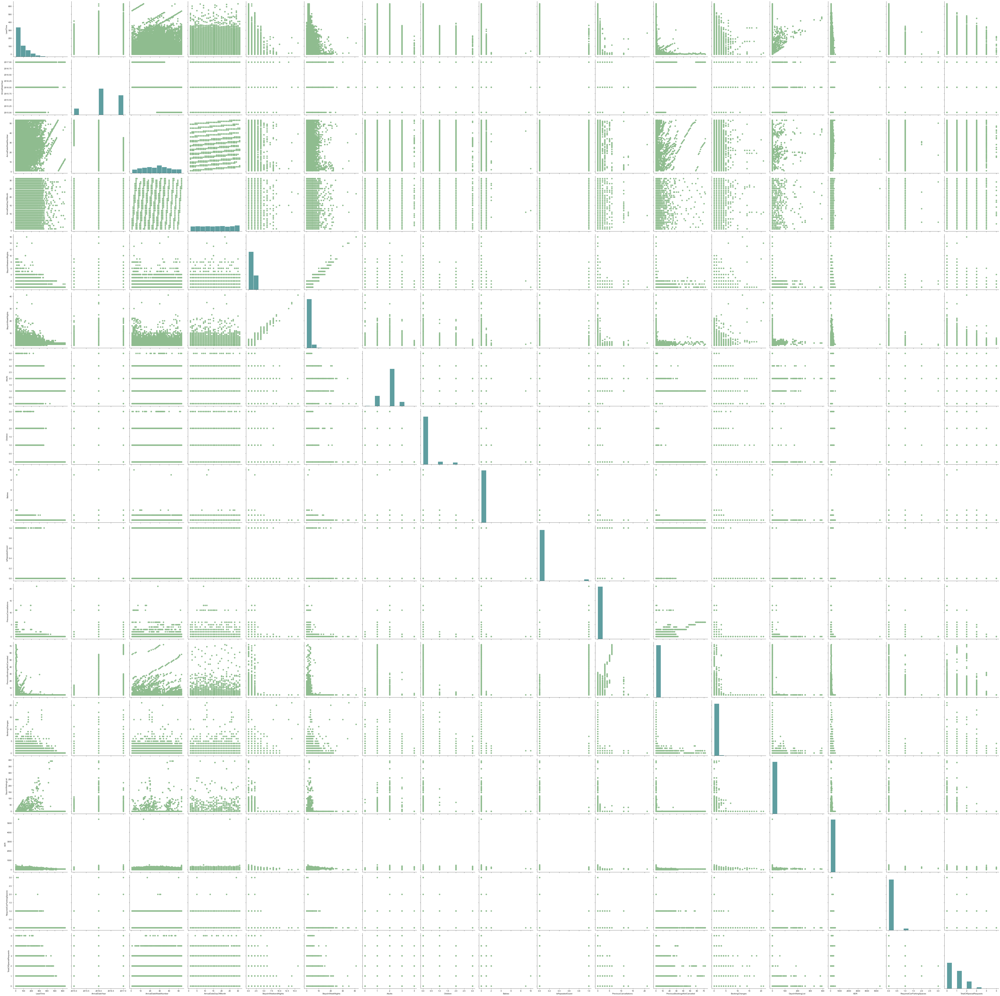

In [13]:
grid = sns.PairGrid(data= bookings, vars = bookings[['LeadTime', 'ArrivalDateYear',
       'ArrivalDateWeekNumber', 'ArrivalDateDayOfMonth',
       'StaysInWeekendNights', 'StaysInWeekNights', 'Adults', 'Children',
       'Babies', 'IsRepeatedGuest', 'PreviousCancellations',
       'PreviousBookingsNotCanceled','BookingChanges', 'DaysInWaitingList','ADR', 'RequiredCarParkingSpaces',
       'TotalOfSpecialRequests']], height = 4)
grid = grid.map_upper(plt.scatter, color = 'darkseagreen')
grid = grid.map_diag(plt.hist, bins = 10, color = 'cadetblue')
grid = grid.map_lower(plt.scatter, color = 'darkseagreen')

<a class="anchor" id="coherencechecking">

__`2.5. Coherence Checking`__ 
    
</a>

In [44]:
bookings.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
IsCanceled,53418.0,NaN,NaN,NaN,0.300292,0.458389,0.0,0.0,0.0,1.0,1.0
LeadTime,53418.0,NaN,NaN,NaN,77.689131,82.113652,0.0,14.0,50.0,118.0,629.0
ArrivalDateYear,53418.0,NaN,NaN,NaN,2016.254109,0.659209,2015.0,2016.0,2016.0,2017.0,2017.0
ArrivalDateMonth,53418,12,August,6587,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ArrivalDateWeekNumber,53418.0,NaN,NaN,NaN,26.635516,13.585946,1.0,16.0,27.0,37.0,53.0
ArrivalDateDayOfMonth,53418.0,NaN,NaN,NaN,15.756056,8.801769,1.0,8.0,16.0,23.0,31.0
StaysInWeekendNights,53418.0,NaN,NaN,NaN,0.87214,0.913676,0.0,0.0,1.0,2.0,16.0
StaysInWeekNights,53418.0,NaN,NaN,NaN,2.274364,1.618204,0.0,1.0,2.0,3.0,41.0
Adults,53418.0,NaN,NaN,NaN,1.876427,0.544125,0.0,2.0,2.0,2.0,4.0
Children,53418.0,NaN,NaN,NaN,0.131866,0.442199,0.0,0.0,0.0,0.0,3.0


In [8]:
# Não há valores negativos (pelas estatísticas descritivas)

# Bookings without people assigned
bookings[bookings['Adults'] + bookings['Children'] + bookings['Babies'] == 0] #-> remove 151
bookings = bookings[bookings['Adults'] + bookings['Children'] + bookings['Babies'] != 0]

# Bookings with babies but without adults
bookings[(bookings['Adults'] == 0) & (bookings['Babies'] >= 1)][['Adults', 'Children','Babies']] #-> remove 3
bookings.drop(bookings[(bookings['Adults'] == 0) & (bookings['Babies'] >= 1)].index, inplace = True)

In [9]:
bookings

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
0,0,6,2015,July,27,1,0,2,1,0,...,No Deposit,6,NULL,0,Transient,0.00,0,0,Check-Out,2015-07-03
1,1,88,2015,July,27,1,0,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-07-01
2,1,65,2015,July,27,1,0,4,1,0,...,No Deposit,9,NULL,0,Transient,68.00,0,1,Canceled,2015-04-30
3,1,92,2015,July,27,1,2,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,2,Canceled,2015-06-23
4,1,100,2015,July,27,2,0,2,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-04-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79325,0,23,2017,August,35,30,2,5,2,0,...,No Deposit,394,NULL,0,Transient,96.14,0,0,Check-Out,2017-09-06
79326,0,102,2017,August,35,31,2,5,3,0,...,No Deposit,9,NULL,0,Transient,225.43,0,2,Check-Out,2017-09-07
79327,0,34,2017,August,35,31,2,5,2,0,...,No Deposit,9,NULL,0,Transient,157.71,0,4,Check-Out,2017-09-07
79328,0,109,2017,August,35,31,2,5,2,0,...,No Deposit,89,NULL,0,Transient,104.40,0,0,Check-Out,2017-09-07


#### Reset Indexes

In [10]:
bookings = bookings.reset_index()
bookings

,index,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
0,0,0,6,2015,July,27,1,0,2,1,...,No Deposit,6,NULL,0,Transient,0.00,0,0,Check-Out,2015-07-03
1,1,1,88,2015,July,27,1,0,4,2,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-07-01
2,2,1,65,2015,July,27,1,0,4,1,...,No Deposit,9,NULL,0,Transient,68.00,0,1,Canceled,2015-04-30
3,3,1,92,2015,July,27,1,2,4,2,...,No Deposit,9,NULL,0,Transient,76.50,0,2,Canceled,2015-06-23
4,4,1,100,2015,July,27,2,0,2,2,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-04-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53259,79325,0,23,2017,August,35,30,2,5,2,...,No Deposit,394,NULL,0,Transient,96.14,0,0,Check-Out,2017-09-06
53260,79326,0,102,2017,August,35,31,2,5,3,...,No Deposit,9,NULL,0,Transient,225.43,0,2,Check-Out,2017-09-07
53261,79327,0,34,2017,August,35,31,2,5,2,...,No Deposit,9,NULL,0,Transient,157.71,0,4,Check-Out,2017-09-07
53262,79328,0,109,2017,August,35,31,2,5,2,...,No Deposit,89,NULL,0,Transient,104.40,0,0,Check-Out,2017-09-07


In [11]:
bookings.drop('index', axis = 1, inplace = True)
bookings

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
0,0,6,2015,July,27,1,0,2,1,0,...,No Deposit,6,NULL,0,Transient,0.00,0,0,Check-Out,2015-07-03
1,1,88,2015,July,27,1,0,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-07-01
2,1,65,2015,July,27,1,0,4,1,0,...,No Deposit,9,NULL,0,Transient,68.00,0,1,Canceled,2015-04-30
3,1,92,2015,July,27,1,2,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,2,Canceled,2015-06-23
4,1,100,2015,July,27,2,0,2,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-04-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53259,0,23,2017,August,35,30,2,5,2,0,...,No Deposit,394,NULL,0,Transient,96.14,0,0,Check-Out,2017-09-06
53260,0,102,2017,August,35,31,2,5,3,0,...,No Deposit,9,NULL,0,Transient,225.43,0,2,Check-Out,2017-09-07
53261,0,34,2017,August,35,31,2,5,2,0,...,No Deposit,9,NULL,0,Transient,157.71,0,4,Check-Out,2017-09-07
53262,0,109,2017,August,35,31,2,5,2,0,...,No Deposit,89,NULL,0,Transient,104.40,0,0,Check-Out,2017-09-07


<a class="anchor" id="datapreparation">

## 3. Data Preparation

</a>

<a class="anchor" id="outliers">

__`3.1. Outliers`__ 
    
</a>

In [15]:
def show_plots(feature):
    fig = px.histogram(bookings, x=bookings[feature], color_discrete_sequence=['darkseagreen'], template='plotly_white', \
                   width=950, height=350)
    fig.show()

    fig = px.box(bookings, y=bookings[feature], color_discrete_sequence=['dimgrey'], template='plotly_white', \
                 width=400, height=350)
    fig.show()

In [16]:
show_plots('LeadTime')

In [17]:
show_plots('ArrivalDateYear')

In [18]:
show_plots('ArrivalDateWeekNumber')

In [19]:
show_plots('ArrivalDateDayOfMonth')

In [20]:
show_plots('StaysInWeekendNights')

In [21]:
show_plots('Adults')

In [22]:
show_plots('Children')

In [23]:
show_plots('Babies')

In [24]:
show_plots('PreviousCancellations')

In [25]:
show_plots('PreviousBookingsNotCanceled')

In [26]:
show_plots('BookingChanges')

In [27]:
show_plots('DaysInWaitingList')

In [28]:
show_plots('ADR')

In [29]:
show_plots('RequiredCarParkingSpaces')

In [30]:
show_plots('TotalOfSpecialRequests')

In [52]:
bookings_final = bookings.copy()

In [53]:
filter = (
   (bookings_final['StaysInWeekendNights'] < 10)
   &
   (bookings_final['Babies'] < 8)
   &
   (bookings_final['PreviousCancellations'] < 10)
   &
   (bookings_final['BookingChanges'] < 19)
   &
   (bookings_final['DaysInWaitingList'] < 147)
   &
   (bookings_final['ADR'] < 400)
)


bookings_final = bookings_final[filter]

perc_outliers = np.round((bookings.shape[0] - bookings_final.shape[0]) / bookings.shape[0] * 100, 2)
print(f'Percentage of observations removed: {perc_outliers}%')

Percentage of observations removed: 0.29%


In [54]:
bookings_final = bookings_final.reset_index()
bookings_final.drop('index', inplace = True, axis = 1)
bookings_final             

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,DepositType,Agent,Company,DaysInWaitingList,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,ReservationStatus,ReservationStatusDate
0,0,6,2015,July,27,1,0,2,1,0,...,No Deposit,6,NULL,0,Transient,0.00,0,0,Check-Out,2015-07-03
1,1,88,2015,July,27,1,0,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-07-01
2,1,65,2015,July,27,1,0,4,1,0,...,No Deposit,9,NULL,0,Transient,68.00,0,1,Canceled,2015-04-30
3,1,92,2015,July,27,1,2,4,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,2,Canceled,2015-06-23
4,1,100,2015,July,27,2,0,2,2,0,...,No Deposit,9,NULL,0,Transient,76.50,0,1,Canceled,2015-04-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,0,23,2017,August,35,30,2,5,2,0,...,No Deposit,394,NULL,0,Transient,96.14,0,0,Check-Out,2017-09-06
53103,0,102,2017,August,35,31,2,5,3,0,...,No Deposit,9,NULL,0,Transient,225.43,0,2,Check-Out,2017-09-07
53104,0,34,2017,August,35,31,2,5,2,0,...,No Deposit,9,NULL,0,Transient,157.71,0,4,Check-Out,2017-09-07
53105,0,109,2017,August,35,31,2,5,2,0,...,No Deposit,89,NULL,0,Transient,104.40,0,0,Check-Out,2017-09-07


#### Divide the dataset into metric and non-metric features to apply DBSCAN

In [15]:
# Subset of data including only the numerical features
data_metric = bookings_final.select_dtypes(include=np.number).set_index(bookings_final.index)

# Subset of data including only the non numerical features
data_non_metric = bookings_final.select_dtypes(exclude=np.number).set_index(bookings_final.index)
data_metric

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,Babies,IsRepeatedGuest,PreviousCancellations,PreviousBookingsNotCanceled,BookingChanges,DaysInWaitingList,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests
0,0,6,2015,27,1,0,2,1,0,0,0,0,0,0,0,0.00,0,0
1,1,88,2015,27,1,0,4,2,0,0,0,0,0,0,0,76.50,0,1
2,1,65,2015,27,1,0,4,1,0,0,0,0,0,0,0,68.00,0,1
3,1,92,2015,27,1,2,4,2,0,0,0,0,0,0,0,76.50,0,2
4,1,100,2015,27,2,0,2,2,0,0,0,0,0,0,0,76.50,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,0,23,2017,35,30,2,5,2,0,0,0,0,0,0,0,96.14,0,0
53103,0,102,2017,35,31,2,5,3,0,0,0,0,0,0,0,225.43,0,2
53104,0,34,2017,35,31,2,5,2,0,0,0,0,0,0,0,157.71,0,4
53105,0,109,2017,35,31,2,5,2,0,0,0,0,0,0,0,104.40,0,0


## DBSCAN FOR OUTLIERS

In [24]:
# from sklearn.cluster import DBSCAN

In [25]:
# # Perform DBSCAN clustering
# dbscan = DBSCAN(eps=1.9, min_samples=42, n_jobs=4)
# dbscan_labels = dbscan.fit_predict(data_metric)

# dbscan_n_clusters = len(np.unique(dbscan_labels))
# print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 5


In [26]:
# df_concat = pd.concat([data_metric, pd.Series(dbscan_labels, index=data_metric.index, name="dbscan_labels")], axis=1)
# df_concat.head(20)

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,Babies,IsRepeatedGuest,PreviousCancellations,PreviousBookingsNotCanceled,BookingChanges,DaysInWaitingList,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,dbscan_labels
0,0,6,2015,27,1,0,2,1,0,0,0,0,0,0,0,0.00,0,0,-1
1,1,88,2015,27,1,0,4,2,0,0,0,0,0,0,0,76.50,0,1,-1
2,1,65,2015,27,1,0,4,1,0,0,0,0,0,0,0,68.00,0,1,-1
3,1,92,2015,27,1,2,4,2,0,0,0,0,0,0,0,76.50,0,2,-1
4,1,100,2015,27,2,0,2,2,0,0,0,0,0,0,0,76.50,0,1,-1
5,1,79,2015,27,2,0,3,2,0,0,0,0,0,0,0,76.50,0,1,-1
6,0,3,2015,27,2,0,3,1,0,0,0,0,0,1,0,58.67,0,0,-1
7,1,63,2015,27,2,1,3,1,0,0,0,0,0,0,0,68.00,0,0,-1
8,1,62,2015,27,2,2,3,2,0,0,0,0,0,0,0,76.50,0,1,-1
9,0,43,2015,27,3,0,2,2,0,0,0,0,0,0,0,86.00,0,0,-1


In [27]:
# df_concat.loc[df_concat['dbscan_labels'] == -1]

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,Babies,IsRepeatedGuest,PreviousCancellations,PreviousBookingsNotCanceled,BookingChanges,DaysInWaitingList,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,dbscan_labels
0,0,6,2015,27,1,0,2,1,0,0,0,0,0,0,0,0.00,0,0,-1
1,1,88,2015,27,1,0,4,2,0,0,0,0,0,0,0,76.50,0,1,-1
2,1,65,2015,27,1,0,4,1,0,0,0,0,0,0,0,68.00,0,1,-1
3,1,92,2015,27,1,2,4,2,0,0,0,0,0,0,0,76.50,0,2,-1
4,1,100,2015,27,2,0,2,2,0,0,0,0,0,0,0,76.50,0,1,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53259,0,23,2017,35,30,2,5,2,0,0,0,0,0,0,0,96.14,0,0,-1
53260,0,102,2017,35,31,2,5,3,0,0,0,0,0,0,0,225.43,0,2,-1
53261,0,34,2017,35,31,2,5,2,0,0,0,0,0,0,0,157.71,0,4,-1
53262,0,109,2017,35,31,2,5,2,0,0,0,0,0,0,0,104.40,0,0,-1


#### So, we will not take into account the resulted obtained using DBSCAN

<a class="anchor" id="datapreprocessing">

## 4. Data Pre-processing

</a>

<a class="anchor" id="featureengineering">

__`4.1. Feature Engineering`__ 
    
</a>

In [82]:
bookings_final.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
IsCanceled,53107.0,NaN,NaN,NaN,0.301053,0.45872,0.0,0.0,0.0,1.0,1.0
LeadTime,53107.0,NaN,NaN,NaN,77.331482,81.459943,0.0,14.0,50.0,118.0,629.0
ArrivalDateYear,53107.0,NaN,NaN,NaN,2016.254995,0.659799,2015.0,2016.0,2016.0,2017.0,2017.0
ArrivalDateMonth,53107,12,August,6558,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ArrivalDateWeekNumber,53107.0,NaN,NaN,NaN,26.638353,13.576602,1.0,16.0,27.0,37.0,53.0
ArrivalDateDayOfMonth,53107.0,NaN,NaN,NaN,15.760747,8.805982,1.0,8.0,16.0,23.0,31.0
StaysInWeekendNights,53107.0,NaN,NaN,NaN,0.871392,0.901607,0.0,0.0,1.0,2.0,9.0
StaysInWeekNights,53107.0,NaN,NaN,NaN,2.269833,1.579592,0.0,1.0,2.0,3.0,25.0
Adults,53107.0,NaN,NaN,NaN,1.881936,0.535694,0.0,2.0,2.0,2.0,4.0
Children,53107.0,NaN,NaN,NaN,0.132431,0.443034,0.0,0.0,0.0,0.0,3.0


In [16]:
# Convert ArrivalDateMonth names to numbers
bookings_final['ArrivalDateMonth'].replace({'January' : '1',
                                            'February' : '2',
                                            'March' : '3',
                                            'April' : '4',
                                            'May' : '5',
                                            'June' : '6',
                                            'July' : '7',
                                            'August' : '8',
                                            'September' : '9', 
                                            'October' : '10',
                                            'November' : '11',
                                            'December' : '12'}, inplace=True)

bookings_final.ArrivalDateMonth = bookings_final.ArrivalDateMonth.astype('int')
bookings_final['StaysInNights'] = bookings_final['StaysInWeekendNights'] + bookings_final['StaysInWeekNights']
bookings_final['NumberGuests'] = bookings_final['Babies'] + bookings_final['Children'] + bookings_final['Adults']

#### Let's create binary variables based on the categorical ones

In [17]:
# Create binary variables for the most common operating systems
bookings_final['Agent'] = bookings_final['Agent'].apply(lambda x: bool(0) if x == 'NULL' else bool(1))  
bookings_final['Company'] = bookings_final['Company'].apply(lambda x: bool(0) if x == 'NULL' else bool(1))  

bookings_final['CustomerType'] = bookings_final['CustomerType'].apply(lambda x: 'Customer_' + str(x))
customer = pd.DataFrame(pd.get_dummies(bookings_final['CustomerType'], drop_first = True, dtype=bool))

bookings_final['Meal'] = bookings_final['Meal'].apply(lambda x: 'Meal_' + str(x))
meal = pd.DataFrame(pd.get_dummies(bookings_final['Meal'], drop_first = True, dtype=bool))

bookings_final['MarketSegment'] = bookings_final['MarketSegment'].apply(lambda x: 'MarketSegment_' + str(x))
marketseg = pd.DataFrame(pd.get_dummies(bookings_final['MarketSegment'], drop_first = True, dtype=bool))

bookings_final['DistributionChannel'] = bookings_final['DistributionChannel'].apply(lambda x: 'DistributionChannel_' + str(x))
distchannel = pd.DataFrame(pd.get_dummies(bookings_final['DistributionChannel'], drop_first = True, dtype=bool))

# bookings_final['ReservationStatus'] = bookings_final['ReservationStatus'].apply(lambda x: 'ReservationStatus' + str(x))
# status = pd.DataFrame(pd.get_dummies(bookings_final['ReservationStatus'], drop_first = True, dtype=bool))

bookings_final = pd.concat((bookings_final, customer, meal, marketseg, distchannel), axis=1)

In [18]:
bookings_final['RoomChanged'] = 0

In [19]:
for idx, row in bookings_final.iterrows():
    if  bookings_final.loc[idx,'ReservedRoomType'] != bookings_final.loc[idx,'AssignedRoomType']:
        bookings_final.loc[idx,'RoomChanged'] = 1
    else:
        bookings_final.loc[idx,'RoomChanged'] = 0

<a class="anchor" id="featureselection">

__`4.2. Feature Selection`__ 
    
</a>

In [20]:
# Define data as all the independent variables
data = bookings_final.drop(['IsCanceled'], axis=1)

# Define target as the dependent variable
target = bookings_final['IsCanceled']

In [156]:
data.dtypes

LeadTime                         int64
ArrivalDateYear                  int64
ArrivalDateMonth                 int32
ArrivalDateWeekNumber            int64
ArrivalDateDayOfMonth            int64
StaysInWeekendNights             int64
StaysInWeekNights                int64
Adults                           int64
Children                         int32
Babies                           int64
Meal                            object
Country                         object
MarketSegment                   object
DistributionChannel             object
IsRepeatedGuest                  int64
PreviousCancellations            int64
PreviousBookingsNotCanceled      int64
ReservedRoomType                object
AssignedRoomType                object
BookingChanges                   int64
DepositType                     object
Agent                             bool
Company                           bool
DaysInWaitingList                int64
CustomerType                    object
ADR                      

#### Remove the categorical variables used to create the dummy ones

In [21]:
data.drop('Meal', axis=1, inplace=True)
data.drop('Country', axis=1, inplace=True)
data.drop('CustomerType', axis=1, inplace=True)
data.drop('ReservationStatus', axis=1, inplace=True)
data.drop('DistributionChannel', axis=1, inplace=True)
data.drop('MarketSegment', axis=1, inplace=True)
data.drop('DepositType', axis=1, inplace=True)
data.drop('AssignedRoomType', axis=1, inplace=True)
data.drop('ReservedRoomType', axis=1, inplace=True)
data.drop('ReservationStatusDate', axis=1, inplace=True)

In [22]:
data.columns

Index(['LeadTime', 'ArrivalDateYear', 'ArrivalDateMonth',
       'ArrivalDateWeekNumber', 'ArrivalDateDayOfMonth',
       'StaysInWeekendNights', 'StaysInWeekNights', 'Adults', 'Children',
       'Babies', 'IsRepeatedGuest', 'PreviousCancellations',
       'PreviousBookingsNotCanceled', 'BookingChanges', 'Agent', 'Company',
       'DaysInWaitingList', 'ADR', 'RequiredCarParkingSpaces',
       'TotalOfSpecialRequests', 'StaysInNights', 'NumberGuests',
       'Customer_Group', 'Customer_Transient', 'Customer_Transient-Party',
       'Meal_FB       ', 'Meal_HB       ', 'Meal_SC       ',
       'MarketSegment_Complementary', 'MarketSegment_Corporate',
       'MarketSegment_Direct', 'MarketSegment_Groups',
       'MarketSegment_Offline TA/TO', 'MarketSegment_Online TA',
       'DistributionChannel_Direct', 'DistributionChannel_GDS',
       'DistributionChannel_TA/TO', 'RoomChanged'],
      dtype='object')

#### Divide the dataset into metric and non-metric features

In [23]:
# Subset of data including only the numerical features
data_metric = data.select_dtypes(include=np.number).set_index(data.index)

# Subset of data including only the non numerical features
data_non_metric = data.select_dtypes(exclude=np.number).set_index(data.index)
data_non_metric

,Agent,Company,Customer_Group,Customer_Transient,Customer_Transient-Party,Meal_FB,Meal_HB,Meal_SC,MarketSegment_Complementary,MarketSegment_Corporate,MarketSegment_Direct,MarketSegment_Groups,MarketSegment_Offline TA/TO,MarketSegment_Online TA,DistributionChannel_Direct,DistributionChannel_GDS,DistributionChannel_TA/TO
0,True,True,False,True,False,False,True,False,False,False,False,False,True,False,False,False,True
1,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
2,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
3,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
4,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,True,True,False,True,False,False,False,False,False,False,False,False,True,False,False,False,True
53103,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
53104,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
53105,True,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True


#### Filter Methods

In [24]:
# Scale the data metric
data_metric_scaled = pd.DataFrame(MinMaxScaler().fit_transform(data_metric), columns = data_metric.columns)

# Check if any of the variables is univariate
data_metric_scaled.var()

# There aren't univariate variables so we should keep all

LeadTime                       0.016772
ArrivalDateYear                0.108834
ArrivalDateMonth               0.078023
ArrivalDateWeekNumber          0.068167
ArrivalDateDayOfMonth          0.086161
StaysInWeekendNights           0.010036
StaysInWeekNights              0.003992
Adults                         0.017936
Children                       0.021809
Babies                         0.001786
IsRepeatedGuest                0.029681
PreviousCancellations          0.001598
PreviousBookingsNotCanceled    0.000792
BookingChanges                 0.001414
DaysInWaitingList              0.002521
ADR                            0.012454
RequiredCarParkingSpaces       0.003859
TotalOfSpecialRequests         0.027825
StaysInNights                  0.003557
NumberGuests                   0.030146
RoomChanged                    0.099429
dtype: float64

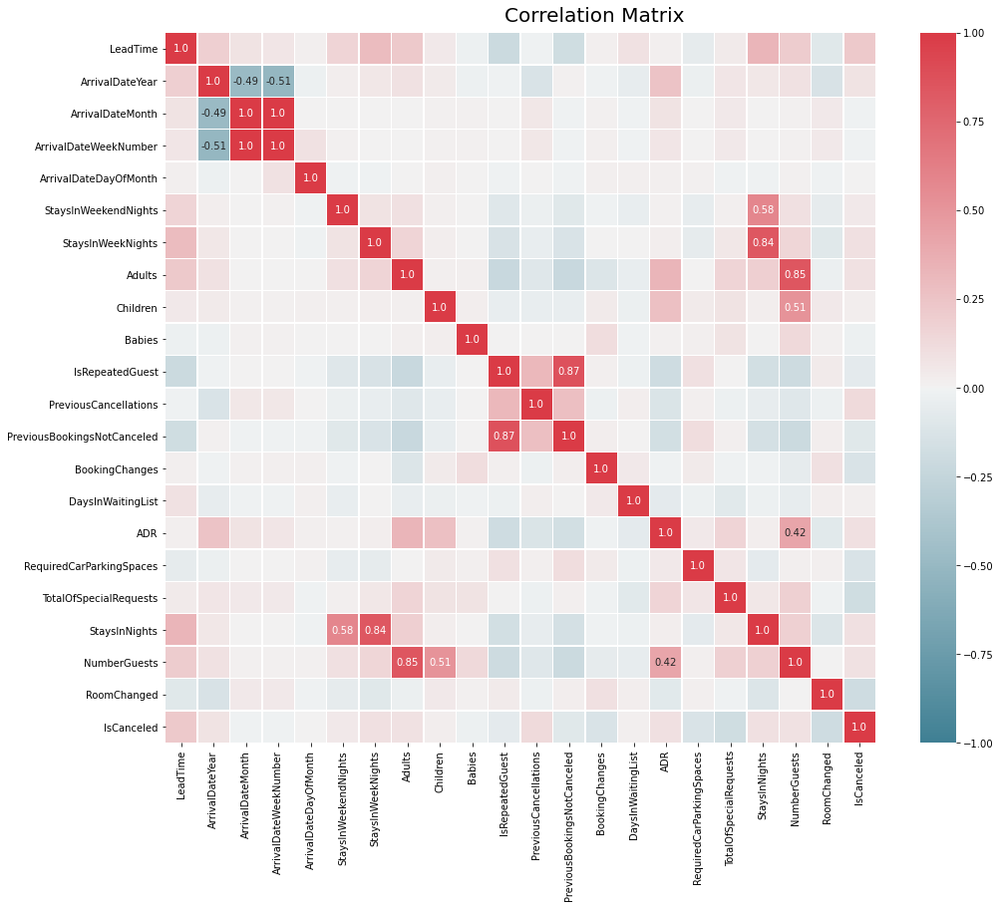

In [25]:
# ------------ Spearman Correlation ------------

# Check correlations
all_data = data_metric.join(target)

# Prepare figure
fig = plt.figure(figsize=(16, 12))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(all_data.corr(method="spearman"), decimals=2)

# Build annotation matrix (values above |0.4| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.4
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)


plt.show()

#### Correlated variables: ArrivalDateMonth and ArrivalDateWeekNumber

#### Wrapper and Embeded Methods

In [26]:
# Create a Stratified KFold with 10 splits
skf = StratifiedKFold(n_splits=10)

In [27]:
from sklearn.linear_model import LassoCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE

### Lasso and Decision Tree

In [163]:
# ----------------------------- Lasso and Decision Tree -----------------------------
fold = 1

for train_index, val_index in skf.split(data_metric, target):
       
       # Data Partition
       X_train, X_val = data_metric.iloc[train_index], data_metric.iloc[val_index]
       y_train, y_val = target.iloc[train_index], target.iloc[val_index]
       
       # Scaling the data with MinMaxScaler
       scaler = MinMaxScaler().fit(X_train)
       
       X_train_metric_scaled = scaler.transform(X_train) # this will return an array
       X_train_metric_scaled = pd.DataFrame(X_train_metric_scaled, columns = X_train.columns)#.set_index(X_train.index)

       X_val_metric_scaled = scaler.transform(X_val)
       X_val_metric_scaled = pd.DataFrame(X_val_metric_scaled, columns = X_val.columns)#.set_index(X_val.index)
       
       
       # CODE FOR LASSO
       reg = LassoCV()
       lasso = reg.fit(X_train_metric_scaled, y_train)
       importance = np.abs(lasso.coef_)
       
       # CODE FOR DT
       gini_importance = DecisionTreeClassifier().fit(X = X_train_metric_scaled, y = y_train).feature_importances_
       entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X = X_train_metric_scaled, y = y_train).feature_importances_
       
       
       if fold == 1:
           # Create three empty data frames
           lasso_results = pd.DataFrame(index = X_train_metric_scaled.columns)
           gini_results = pd.DataFrame(index = X_train_metric_scaled.columns)
           entropy_results = pd.DataFrame(index = X_train_metric_scaled.columns)
           
       importance_values = pd.Series(importance, index = X_train_metric_scaled.columns, name=f'Partition {fold}')
       gini_values = pd.Series(gini_importance, index = X_train_metric_scaled.columns, name=f'Partition {fold}')
       entropy_values = pd.Series(entropy_importance, index = X_train_metric_scaled.columns, name=f'Partition {fold}')

       lasso_results = pd.concat((lasso_results, importance_values), axis=1)
       gini_results = pd.concat((gini_results, gini_values), axis=1)
       entropy_results = pd.concat((entropy_results, entropy_values), axis=1)
       
       fold+=1
              
       
# Add new column with average of importance        
importance_lasso_list = []
importance_gini_list = []
importance_entropy_list = []

for index, row in lasso_results.iterrows():
   count = 0
   for elem in row:
       count+=elem
   average = count / 10
   importance_lasso_list.append(average)

for index, row in gini_results.iterrows():
   count = 0
   for elem in row:
       count+=elem
   average = count / 10
   importance_gini_list.append(average)
   
for index, row in entropy_results.iterrows():
   count = 0
   for elem in row:
       count+=elem
   average = count / 10
   importance_entropy_list.append(average)

lasso_results['Average of LASSO Importance'] = importance_lasso_list 
gini_results['Average of Gini Importance'] = importance_gini_list
entropy_results['Average of Entropy Importance'] = importance_entropy_list
dt_results = pd.merge(gini_results['Average of Gini Importance'], entropy_results['Average of Entropy Importance'], left_index = True, right_index = True)
importance_results = pd.merge(dt_results, lasso_results['Average of LASSO Importance'], left_index = True, right_index = True)

lasso_results.style.applymap(lambda x: 'background-color : green' if x > 0.01 else ('background-color : red' if x < -0.85 else ''))

importance_results.sort_values(by=['Average of LASSO Importance','Average of Gini Importance','Average of Entropy Importance'], ascending=False)

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.049956375316924, tolerance: 0.4219123417721549
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.496892513150215, tolerance: 0.4219123417721549
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.47309135003161, tolerance: 0.4219123417721549
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.1409878273098, tolerance: 0.896407594738068
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.57012225781, tolerance: 0.896407594738068
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 61.50943652924798, tolerance: 0.896407594738068
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_c

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.5302212694468835, tolerance: 0.8972281716661883
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.376663818044108, tolerance: 0.8972281716661883
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.73502395716969, tolerance: 0.8972281716661883
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.722504803994525, tolerance: 0.6595961606862604
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.946729866369424, tolerance: 0.6595961606862604
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.7331380002197, tolerance: 0.6595961606862604
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_m

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.516048285784564, tolerance: 0.8964075947380683
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.17277844092041, tolerance: 0.8964075947380683
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.76453095823126, tolerance: 0.8964075947380683
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_m

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.500799630102847, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.073486476966536, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.75669242892218, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7575257280159349, tolerance: 0.5292118628553553
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.398568368834276, tolerance: 0.5292118628553553
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.756928616838195, tolerance: 0.5292118628553553
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3670140522262955, tolerance: 0.8868172241546259
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.009479199776251, tolerance: 0.8868172241546259
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.981723201690329, tolerance: 0.8868172241546259
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.56215585251084, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.608857339242604, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.01319221521862, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.032585849494353, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.127026593039773, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.24296938162206, tolerance: 0.6595961606862581
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.686401550461596, tolerance: 0.5292118628553552
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.32020851925654, tolerance: 0.5292118628553552
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.96771895663096, tolerance: 0.5292118628553552
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.11288002037236, tolerance: 0.897153809137745
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.45545479656539, tolerance: 0.897153809137745
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.84508465297404, tolerance: 0.897153809137745
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_mode

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.1479263305445784, tolerance: 0.6587046866826939
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.123780514045393, tolerance: 0.6587046866826939
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.038638329991045, tolerance: 0.6587046866826939
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.252808661456584, tolerance: 0.8870858383241416
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.7257721387723, tolerance: 0.8870858383241416
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 51.351405599903046, tolerance: 0.8870858383241416
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.655338226559252, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.97128187445833, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.406502472267675, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3444019924463646, tolerance: 0.6587046866826938
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.21730975101127, tolerance: 0.6587046866826938
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.60993102397697, tolerance: 0.6587046866826938
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.711717869653512, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.04190601384107, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.364946260149736, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.85817811310426, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.86004426464024, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.669866650485346, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.108487873275408, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.848500573531965, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.364549519857974, tolerance: 0.8870858383241418
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.896970087384943, tolerance: 0.8969055940581159
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.80365733196413, tolerance: 0.8969055940581159
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.51415317005649, tolerance: 0.8969055940581159
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.011146385107168, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.184248316969388, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.21953798150753, tolerance: 0.8972281716661863
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.512091486515601, tolerance: 0.6587653372387995
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.804915862983762, tolerance: 0.6587653372387995
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.32634321006117, tolerance: 0.6587653372387995
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.10216000737, tolerance: 0.8871260552329967
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.085007602978294, tolerance: 0.8871260552329967
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.02801492313756, tolerance: 0.8871260552329967
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_mod

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.38995154823897, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 51.98293645240574, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 51.55236277291442, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_m

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.411876936750105, tolerance: 0.5302801893454017
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.435153652160807, tolerance: 0.5302801893454017
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.13894431672543, tolerance: 0.5302801893454017
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 61.41468770040592, tolerance: 0.8871260552329967
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.938665931206742, tolerance: 0.8970687169831106
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.8809204849058, tolerance: 0.8970687169831106
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_m

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.332552116895386, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 51.864481042566695, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 51.41066810319535, tolerance: 0.8971431481772194
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.438713318450937, tolerance: 0.5011033449276872
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.52848107048021, tolerance: 0.5011033449276872
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.540424004866964, tolerance: 0.5011033449276872
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.593610967643144, tolerance: 0.8974404022176974
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.625599712228905, tolerance: 0.8974404022176974
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.101631139021265, tolerance: 0.8974404022176974
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linea

,Average of Gini Importance,Average of Entropy Importance,Average of LASSO Importance
RoomChanged,0.042090,0.039393,4.959059e-14
LeadTime,0.230370,0.229910,0.000000e+00
ADR,0.161037,0.165075,0.000000e+00
ArrivalDateDayOfMonth,0.107021,0.113934,0.000000e+00
ArrivalDateWeekNumber,0.103825,0.108528,0.000000e+00
TotalOfSpecialRequests,0.053155,0.046646,0.000000e+00
StaysInNights,0.050253,0.049910,0.000000e+00
StaysInWeekNights,0.043220,0.044249,0.000000e+00
ArrivalDateYear,0.037500,0.035586,0.000000e+00
BookingChanges,0.029258,0.024756,0.000000e+00


### RFE

In [164]:
# ----------------------------- RFE -----------------------------
fold = 1

for train_index, val_index in skf.split(data_metric, target):
       
       # Data Partition
       X_train, X_val = data_metric.iloc[train_index], data_metric.iloc[val_index]
       y_train, y_val = target.iloc[train_index], target.iloc[val_index]
       
       # Scaling the data with MinMaxScaler
       scaler = MinMaxScaler().fit(X_train)
       
       X_train_metric_scaled = scaler.transform(X_train) # this will return an array
       X_train_metric_scaled = pd.DataFrame(X_train_metric_scaled, columns = X_train.columns)#.set_index(X_train.index)

       X_val_metric_scaled = scaler.transform(X_val)
       X_val_metric_scaled = pd.DataFrame(X_val_metric_scaled, columns = X_val.columns)#.set_index(X_val.index)
       
       
       # CODE FOR RFE
       nof_list = np.arange(1,len(data_metric.columns)+1)  # Array from 1 to 21           
       high_score = 0
       nof = 0  # Variable to store the optimum number of features
       
       for n in nof_list:
           
           model = LogisticRegression()
           rfe = RFE(model, n)
           
           X_train_rfe = rfe.fit_transform(X_train_metric_scaled,y_train)
           X_val_rfe = rfe.transform(X_val_metric_scaled)
           
           model.fit(X_train_rfe,y_train)

           score = model.score(X_val_rfe,y_val)
           
           if (score > high_score):
               high_score = score
               nof = n
               selected_features = pd.Series(rfe.support_, index = X_train_metric_scaled.columns, name=f'Partition {fold}')
               
       if fold == 1:
           # Create empty data frame
           rfe_results = pd.DataFrame(index = X_train_metric_scaled.columns)
       
       # Concatenate variables chosen at each partition
       rfe_results = pd.concat((rfe_results, selected_features), axis=1)
       
       print('Fold ',fold)
       fold+=1

# Add new column with count of True's        
count_rfe_list = []
for index, row in rfe_results.iterrows():
   count = 0
   for elem in row:
       if elem == True:
           count+=1
   count_rfe_list.append(count)

rfe_results['Count'] = count_rfe_list

rfe_results.sort_values(by='Count', ascending=False)

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=1 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  1


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=8 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=13 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  2


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=6 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=11 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  3


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=4 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=7 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  4


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=14 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=16 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  5


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=6 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=11 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  6


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=3 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=5 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  7


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=4 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=7 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  8


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=6 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=11 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  9


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=6 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERA

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=11 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass n_features_to_select=16 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITER

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr

Fold  10


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


,Partition 1,Partition 2,Partition 3,Partition 4,Partition 5,Partition 6,Partition 7,Partition 8,Partition 9,Partition 10,Count
RequiredCarParkingSpaces,True,True,True,True,True,True,True,True,True,True,10
LeadTime,False,True,True,True,True,False,True,True,True,False,7
PreviousCancellations,False,True,True,True,True,False,True,True,True,False,7
BookingChanges,False,True,True,True,True,False,True,True,True,False,7
PreviousBookingsNotCanceled,False,True,True,True,True,False,True,True,True,False,7
StaysInNights,False,True,True,True,False,False,True,True,True,False,6
TotalOfSpecialRequests,False,True,True,True,False,False,True,True,True,False,6
ADR,False,True,True,True,False,False,True,True,True,False,6
RoomChanged,False,True,True,True,False,False,True,True,False,False,5
StaysInWeekNights,False,False,True,True,False,False,True,True,False,False,4


In [166]:
# Final table 
final_results = pd.DataFrame(index = X_train_metric_scaled.columns)

final_results['Count RFE'] = count_rfe_list
final_results['Average Importance Lasso'] = importance_results['Average of LASSO Importance']
final_results['Average Importance Gini'] = importance_results['Average of Gini Importance']
final_results['Average Importance Entropy'] = importance_results['Average of Entropy Importance']

final_results.sort_values(by = ['Count RFE', 'Average Importance Lasso', 'Average Importance Gini', 'Average Importance Entropy'], ascending = False, inplace = True)
final_results

,Count RFE,Average Importance Lasso,Average Importance Gini,Average Importance Entropy
RequiredCarParkingSpaces,10,0.000000e+00,0.012707,0.016940
LeadTime,7,0.000000e+00,0.230370,0.229910
BookingChanges,7,0.000000e+00,0.029258,0.024756
PreviousCancellations,7,0.000000e+00,0.022766,0.019246
PreviousBookingsNotCanceled,7,0.000000e+00,0.009336,0.010185
ADR,6,0.000000e+00,0.161037,0.165075
TotalOfSpecialRequests,6,0.000000e+00,0.053155,0.046646
StaysInNights,6,0.000000e+00,0.050253,0.049910
RoomChanged,5,4.959059e-14,0.042090,0.039393
StaysInWeekNights,4,0.000000e+00,0.043220,0.044249


**Select features:** RequiredCarParkingSpaces, LeadTime, BookingChanges, PreviousCancellations, PreviousBookingsNotCanceled, ADR, TotalOfSpecialRequests, StaysInNights, RoomChanged, StaysInWeekNights, NumberGuests, IsRepeatedGuest, ArrivalDateDayOfMonth, ArrivalDateWeekNumber  

In [28]:
bookings_final

,IsCanceled,LeadTime,ArrivalDateYear,ArrivalDateMonth,ArrivalDateWeekNumber,ArrivalDateDayOfMonth,StaysInWeekendNights,StaysInWeekNights,Adults,Children,...,MarketSegment_Complementary,MarketSegment_Corporate,MarketSegment_Direct,MarketSegment_Groups,MarketSegment_Offline TA/TO,MarketSegment_Online TA,DistributionChannel_Direct,DistributionChannel_GDS,DistributionChannel_TA/TO,RoomChanged
0,0,6,2015,7,27,1,0,2,1,0,...,False,False,False,False,True,False,False,False,True,0
1,1,88,2015,7,27,1,0,4,2,0,...,False,False,False,False,False,True,False,False,True,0
2,1,65,2015,7,27,1,0,4,1,0,...,False,False,False,False,False,True,False,False,True,0
3,1,92,2015,7,27,1,2,4,2,0,...,False,False,False,False,False,True,False,False,True,0
4,1,100,2015,7,27,2,0,2,2,0,...,False,False,False,False,False,True,False,False,True,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,0,23,2017,8,35,30,2,5,2,0,...,False,False,False,False,True,False,False,False,True,0
53103,0,102,2017,8,35,31,2,5,3,0,...,False,False,False,False,False,True,False,False,True,0
53104,0,34,2017,8,35,31,2,5,2,0,...,False,False,False,False,False,True,False,False,True,0
53105,0,109,2017,8,35,31,2,5,2,0,...,False,False,False,False,False,True,False,False,True,0


In [29]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

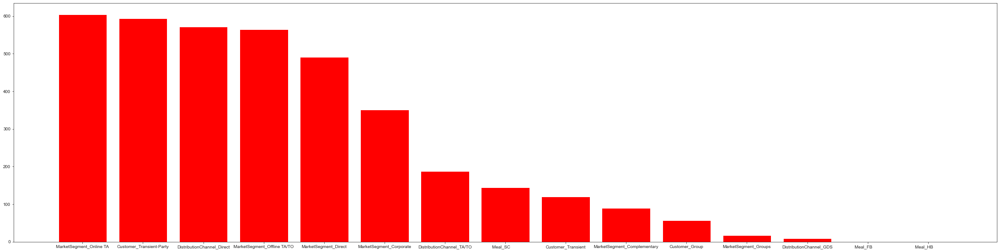

In [172]:
# Find the most important categorical features
kbest = SelectKBest(score_func = chi2, k=15)
kbest_fit = kbest.fit_transform(data_non_metric, target)
best = kbest.get_support()

indices = np.argsort(kbest.scores_)[::-1]

features = []
for i in range(15):
    features.append(data_non_metric.columns[indices[i]])

f = plt.figure()
f.set_figwidth(40)
f.set_figheight(10)
plt.bar(features, kbest.scores_[indices[range(15)]], color='r', align='center')
plt.show()

In [30]:
selected_features = ['RequiredCarParkingSpaces', 'LeadTime', 'BookingChanges', 'PreviousCancellations', 
                     'PreviousBookingsNotCanceled', 'ADR', 'TotalOfSpecialRequests', 'StaysInNights',
                     'RoomChanged', 'StaysInWeekNights', 'NumberGuests', 'IsRepeatedGuest', 'ArrivalDateDayOfMonth', 
                     'ArrivalDateWeekNumber', 'MarketSegment_Online TA', 'Customer_Transient-Party',
                     'DistributionChannel_Direct', 'MarketSegment_Offline TA/TO', 'MarketSegment_Direct',
                     'MarketSegment_Corporate']

<a class="anchor" id="scaling">

__`4.3. Scaling`__ 
    
</a>

In [174]:
def Scaler(data, scaler):
    scaler = scaler
    data_scaled = pd.DataFrame(scaler.fit_transform(data), columns=data.columns, index=data.index)
    return round(data_scaled, 4)

data_MinMax = Scaler(data_metric, MinMaxScaler())
data_standard = Scaler(data_metric, StandardScaler())

<a class="anchor" id="pca">

__`4.4. Dimensionality Reduction - PCA`__ 
    
</a>

In [82]:
data_pca = data_metric.copy()
pca = PCA()
pca_feat = pca.fit_transform(data_pca)
pca_feat
pd.DataFrame({"Eigenvalue": pca.explained_variance_,
             "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
             "Proportion": pca.explained_variance_ratio_,
             "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
            index=range(1, pca.n_components_ + 1))

,Eigenvalue,Difference,Proportion,Cumulative
1,6.639559e+03,0.000000e+00,7.619933e-01,0.761993
2,1.755299e+03,-4.884260e+03,2.014480e-01,0.963441
3,1.926203e+02,-1.562679e+03,2.210620e-02,0.985547
4,7.653838e+01,-1.160819e+02,8.783977e-03,0.994331
5,3.586591e+01,-4.067247e+01,4.116175e-03,0.998448
6,6.355402e+00,-2.951051e+01,7.293818e-04,0.999177
7,4.057778e+00,-2.297624e+00,4.656935e-04,0.999643
8,8.521449e-01,-3.205633e+00,9.779696e-05,0.999741
9,7.065331e-01,-1.456118e-01,8.108573e-05,0.999822
10,5.220251e-01,-1.845080e-01,5.991054e-05,0.999882


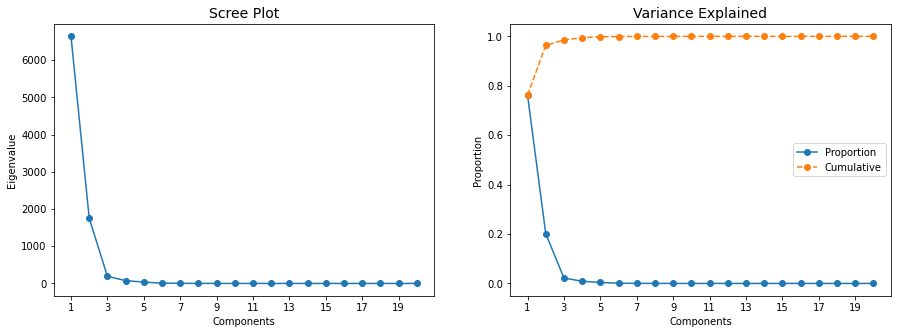

In [288]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [290]:
# Perform PCA again with the number of principal components to retain based on the 3 criteria -> 3
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(data_pca)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=data_metric.index, columns=pca_feat_names)  # remember index=df_pca.index
display(pca_df)

# If we want to select the variables from PCA
data_selected_pca = pca_df.copy()

,PC0,PC1,PC2
0,-69.236325,-112.607084,-2.588139
1,11.293219,-34.586316,0.314503
2,-11.538424,-43.525824,-0.230467
3,15.302988,-34.503906,0.384706
4,23.276822,-34.363726,0.399566
...,...,...,...
79325,-53.818885,-15.856918,-10.903735
79326,22.692737,114.870838,-7.064294
79327,-43.993021,45.903422,-9.555320
79328,31.996721,-5.983900,-9.456578


In [41]:
data_pca = pd.concat([data_pca, pca_df], axis=1)
# Interpreting each Principal Component
loadings = data_pca[list(data_metric.columns) + pca_feat_names].corr().loc[list(data_metric.columns), pca_feat_names]
loadings

NameError: name 'data_pca' is not defined

#### Let's concatenate metric and non-metric features again

In [31]:
data = pd.concat([data_metric, data_non_metric], axis = 1)

In [32]:
data_selected = data[selected_features]
data_selected

,RequiredCarParkingSpaces,LeadTime,BookingChanges,PreviousCancellations,PreviousBookingsNotCanceled,ADR,TotalOfSpecialRequests,StaysInNights,RoomChanged,StaysInWeekNights,NumberGuests,IsRepeatedGuest,ArrivalDateDayOfMonth,ArrivalDateWeekNumber,MarketSegment_Online TA,Customer_Transient-Party,DistributionChannel_Direct,MarketSegment_Offline TA/TO,MarketSegment_Direct,MarketSegment_Corporate
0,0,6,0,0,0,0.00,0,2,0,2,1,0,1,27,False,False,False,True,False,False
1,0,88,0,0,0,76.50,1,4,0,4,2,0,1,27,True,False,False,False,False,False
2,0,65,0,0,0,68.00,1,4,0,4,1,0,1,27,True,False,False,False,False,False
3,0,92,0,0,0,76.50,2,6,0,4,2,0,1,27,True,False,False,False,False,False
4,0,100,0,0,0,76.50,1,2,0,2,2,0,2,27,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,0,23,0,0,0,96.14,0,7,0,5,2,0,30,35,False,False,False,True,False,False
53103,0,102,0,0,0,225.43,2,7,0,5,3,0,31,35,True,False,False,False,False,False
53104,0,34,0,0,0,157.71,4,7,0,5,2,0,31,35,True,False,False,False,False,False
53105,0,109,0,0,0,104.40,0,7,0,5,2,0,31,35,True,False,False,False,False,False


In [69]:
data.IsRepeatedGuest = data.IsRepeatedGuest.astype('int')
data.Agent = data.Agent.astype('int')
data.Company = data.Company.astype('int')
data.Customer_Group = data.Customer_Group.astype('int')
data.Customer_Transient = data.Customer_Transient.astype('int')
data['Customer_Transient-Party'] = data['Customer_Transient-Party'].astype('int')
data['Meal_FB       '] = data['Meal_FB       '].astype('int')
data['Meal_HB       '] = data['Meal_HB       '].astype('int')
data['Meal_SC       '] = data['Meal_SC       '].astype('int')
data.MarketSegment_Complementary = data.MarketSegment_Complementary.astype('int')
data.MarketSegment_Corporate = data.MarketSegment_Corporate.astype('int')
data.MarketSegment_Direct = data.MarketSegment_Direct.astype('int')
data.MarketSegment_Complementary = data.MarketSegment_Complementary.astype('int')
data.MarketSegment_Corporate = data.MarketSegment_Corporate.astype('int')
data.MarketSegment_Direct = data.MarketSegment_Direct.astype('int')
data.MarketSegment_Groups = data.MarketSegment_Groups.astype('int')
data['MarketSegment_Offline TA/TO'] = data['MarketSegment_Offline TA/TO'].astype('int')
data['MarketSegment_Online TA'] = data['MarketSegment_Online TA'].astype('int')
data['DistributionChannel_Direct'] = data['DistributionChannel_Direct'].astype('int')
data['DistributionChannel_GDS'] = data['DistributionChannel_GDS'].astype('int')
data['DistributionChannel_TA/TO'] = data['DistributionChannel_TA/TO'].astype('int')

<a class="anchor" id="modelling">

## 5. Modelling

</a>

In [33]:
def measures(y_train, pred_train , y_val, pred_val):
    
    print('______________________________________________________')
    print('                        TRAIN                         ')
    print('------------------------------------------------------')
    print(classification_report(y_train, pred_train))
    print(confusion_matrix(y_train, pred_train))
    print()
    print('______________________________________________________')
    print('                      VALIDATION                      ')
    print('------------------------------------------------------')
    print(classification_report(y_val, pred_val))
    print(confusion_matrix(y_val, pred_val))

In [34]:
def scaling(X_train, X_val, scaler):
    
        # Separate X_train in metric and non metric features
        X_train_metric = X_train.select_dtypes(include=np.number).set_index(X_train.index)
        X_train_non_metric = X_train.select_dtypes(exclude=np.number).set_index(X_train.index)

        # Separate X_val in metric and non metric features
        X_val_metric = X_val.select_dtypes(include=np.number).set_index(X_val.index)
        X_val_non_metric = X_val.select_dtypes(exclude=np.number).set_index(X_val.index)

        # Create a scalling method        
        scaler = scaler.fit(X_train_metric)

        # Scalling the X_train_metric
        X_train_metric_scaled = scaler.transform(X_train_metric) 
        X_train_metric_scaled = pd.DataFrame(X_train_metric_scaled, columns = X_train_metric.columns).set_index(X_train_metric.index)

        # Scalling the X_val_metric
        X_val_metric_scaled = scaler.transform(X_val_metric) 
        X_val_metric_scaled = pd.DataFrame(X_val_metric_scaled, columns = X_val_metric.columns).set_index(X_val.index)


        # Join the X_train and X_val back together
        X_train = X_train_metric_scaled.join(X_train_non_metric)
        X_val = X_val_metric_scaled.join(X_val_non_metric)  
        
        return X_train, X_val

In [46]:
def run_grid2(X, y, random_state, model, parameters, scale_data=False, scaler=MinMaxScaler()):
    
    tscv = TimeSeriesSplit(n_splits=3, test_size=2, gap=2)
    for train_index, test_index in tscv.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
    
    # Do a train_test_split with a predefined random_state
    #X_train, X_val, y_train, y_val = train_test_split(X, y, train_size=0.8, stratify = target, random_state=random_state)
        
###################### SCALE THE DATA ########################
    if scale_data:
        X_train, X_test = scaling(X_train, X_test, scaler)

###################### DEFINE OUR GRID SEARCH ################
    model_grid = GridSearchCV(estimator = model, param_grid = parameters, scoring='f1', n_jobs=-1, cv=2)
    
    grid_search = model_grid.fit(X_train, y_train)

    print(f'Best parameters= {grid_search.best_params_}')
    print(f'Best score= {grid_search.best_score_}')

In [35]:
def run_grid(X, y, random_state, model, parameters, scale_data=False, scaler=MinMaxScaler()):
    
    # Do a train_test_split with a predefined random_state
    X_train, X_val, y_train, y_val = train_test_split(X, y, train_size=0.8, stratify = target, random_state=random_state)
        
###################### SCALE THE DATA ########################
    if scale_data:
        X_train, X_val = scaling(X_train, X_val, scaler)

###################### DEFINE OUR GRID SEARCH ################
    model_grid = GridSearchCV(estimator = model, param_grid = parameters, scoring='f1', n_jobs=-1, cv=2)
    
    grid_search = model_grid.fit(X_train, y_train)

    print(f'Best parameters= {grid_search.best_params_}')
    print(f'Best score= {grid_search.best_score_}')

In [36]:
def check_overfitting(X, y, random_state, model, scale_data=False, scaler=MinMaxScaler()):
    
    # Do a train_test_split with a predefined random_state
    X_train, X_val, y_train, y_val = train_test_split(X, y, train_size=0.80, stratify = target, random_state=random_state)
        
###################### SCALE THE DATA ########################
    if scale_data:
        X_train, X_val = scaling(X_train, X_val, scaler)

###################### FIT OUR MODEL ######################
    model = model.fit(X_train, y_train)

    # Predict the dependent variable
    y_train_pred = model.predict(X_train)
    y_val_pred = model.predict(X_val)

    # Calculate de f1 score
    value_train = f1_score(y_train, y_train_pred)
    value_val = f1_score(y_val, y_val_pred)

    # Print the results  
    print('Score of Train:', round(value_train, 5))
    print('Score of Valid:', round(value_val, 5))
    print(f'Difference between Train and Validation: {round(value_train-value_val, 5)}')
    
    
###################### PLOT ROC CURVE ######################   
    plt.figure(figsize=(10,5))
    fpr, tpr, thresholds = metrics.roc_curve(y_train, model.predict_proba(X_train)[:,1])
    auc = metrics.roc_auc_score(y_train,y_train_pred)
    plt.plot(fpr, tpr, label='%s ROC (area = %0.2f)' % ('Train', auc))
        
    fpr, tpr, thresholds = metrics.roc_curve(y_val, model.predict_proba(X_val)[:,1])
    auc = metrics.roc_auc_score(y_val,y_val_pred)
    plt.plot(fpr, tpr, label='%s ROC (area = %0.2f)' % ('Validation', auc))
        
    # Custom settings for the plot 
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('1-Specificity(False Positive Rate)')
    plt.ylabel('Sensitivity(True Positive Rate)')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()
    
    # Call fucntion measures
    measures(y_train, y_train_pred, y_val, y_val_pred)

In [37]:
def avg_score(X, y, split_method, scale_data, model, scaler=MinMaxScaler()):
    
    score_train = []
    score_val = []
    overfit = []
    
    fold=1
    
    for train_index, test_index in split_method.split(X, y=target):
        
        # Data Partition
        X_train, X_val = X.iloc[train_index], X.iloc[test_index]
        y_train, y_val = y.iloc[train_index], y.iloc[test_index]
        
#         print(f'### Fold {fold} ###')
        
###################### SCALE THE DATA ########################
        if scale_data:
            X_train, X_val = scaling(X_train, X_val, scaler)    

###################### FIT OUR MODEL ######################
        model = model.fit(X_train, y_train) 

        # Predict the dependent variable
        y_train_pred = model.predict(X_train)
        y_val_pred = model.predict(X_val)

        # Calculate de f1 score
        value_train = f1_score(y_train, y_train_pred)
        value_val = f1_score(y_val, y_val_pred) 
        value_overfit = np.abs(value_train-value_val)
        
#         print(f'Train: {round(value_train,5)}')
#         print(f'Valid: {round(value_val,5)}')
#         print(f'Overfit: {round(value_overfit,5)}')
#         print('----------------')
        
        # Append results to the lists created above
        score_train.append(value_train)
        score_val.append(value_val)
        overfit.append(value_overfit)
        fold+=1
        
    # Print the results  
    print('\nAverage score of Train:', round(np.mean(score_train), 5))
    print('Average score of Valid:', round(np.mean(score_val), 5))
    print(f'Average of overfit: {round(np.mean(overfit), 5)}')


In [38]:
skf = StratifiedKFold(n_splits=5)

# ---------- MINMAX SCALER ----------
min_max = MinMaxScaler()
min_max2 = MinMaxScaler(feature_range = (-1,1))

# ---------- STANDARD SCALER ----------
standard_scaler = StandardScaler()

# ---------- ROBUST SCALER ----------
robust_scaler = RobustScaler()

# LIST WITH ALL SCALLING METHODS
scalling = [min_max, min_max2, standard_scaler, robust_scaler]

In [39]:
data_selected

,RequiredCarParkingSpaces,LeadTime,BookingChanges,PreviousCancellations,PreviousBookingsNotCanceled,ADR,TotalOfSpecialRequests,StaysInNights,RoomChanged,StaysInWeekNights,NumberGuests,IsRepeatedGuest,ArrivalDateDayOfMonth,ArrivalDateWeekNumber,MarketSegment_Online TA,Customer_Transient-Party,DistributionChannel_Direct,MarketSegment_Offline TA/TO,MarketSegment_Direct,MarketSegment_Corporate
0,0,6,0,0,0,0.00,0,2,0,2,1,0,1,27,False,False,False,True,False,False
1,0,88,0,0,0,76.50,1,4,0,4,2,0,1,27,True,False,False,False,False,False
2,0,65,0,0,0,68.00,1,4,0,4,1,0,1,27,True,False,False,False,False,False
3,0,92,0,0,0,76.50,2,6,0,4,2,0,1,27,True,False,False,False,False,False
4,0,100,0,0,0,76.50,1,2,0,2,2,0,2,27,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53102,0,23,0,0,0,96.14,0,7,0,5,2,0,30,35,False,False,False,True,False,False
53103,0,102,0,0,0,225.43,2,7,0,5,3,0,31,35,True,False,False,False,False,False
53104,0,34,0,0,0,157.71,4,7,0,5,2,0,31,35,True,False,False,False,False,False
53105,0,109,0,0,0,104.40,0,7,0,5,2,0,31,35,True,False,False,False,False,False


In [187]:
target

0        0
1        1
2        1
3        1
4        1
        ..
53102    0
53103    0
53104    0
53105    0
53106    0
Name: IsCanceled, Length: 53107, dtype: int64

## Models

### Decision Tree

In [60]:
model_dt = DecisionTreeClassifier()

param_dt = {
    'criterion': ['gini', 'entropy'], 
    'splitter': ['best', 'random'],
    'max_depth': [4,5,6,7],
    'min_samples_split': [200,300],
    'min_samples_leaf': [200,300],
#    'min_weight_fraction_leaf': [0.0],
    'max_features': [2,4,6, None],
#   'random_state'=None,
    'max_leaf_nodes': [4,8, None],
#    'min_impurity_decrease'=0.0,
#    'min_impurity_split'=None,
#    'class_weight'=None,
#    'ccp_alpha'=0.0,
    }

# ------------------------------------------
run_grid(bookings_final, target, random_state=0, scale_data=False, model=model_dt, parameters=param_dt)

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:918: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan n

ValueError: could not convert string to float: 'January'

Score of Train: 0.53907
Score of Valid: 0.5419
Difference between Train and Validation: -0.00283


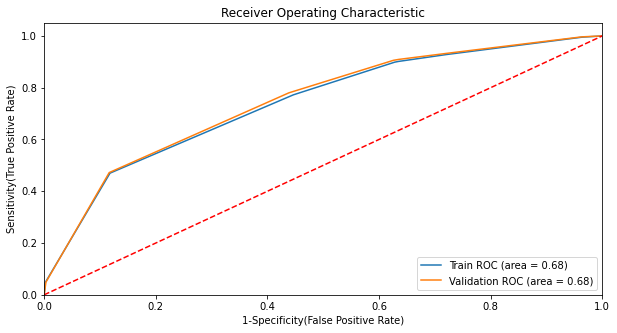

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.79      0.88      0.84     29695
           1       0.63      0.47      0.54     12790

    accuracy                           0.76     42485
   macro avg       0.71      0.68      0.69     42485
weighted avg       0.75      0.76      0.75     42485

[[26192  3503]
 [ 6778  6012]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.80      0.88      0.84      7424
           1       0.64      0.47      0.54      3198

    accuracy                           0.76     10622
   macro avg       0.72      0.68      0.69     10622
weighted avg       0.75      0.76      

In [43]:
DecisionTree = DecisionTreeClassifier(    
        criterion='gini',
        max_depth= 5, 
        max_features= 6,
        splitter='best',
        max_leaf_nodes= 8,
        min_samples_leaf= 200,
        min_samples_split= 300,
        )

# -------------------------------------------------------------------------------------------
check_overfitting(data_selected, target, random_state=0, scale_data=False, model=DecisionTree)

In [44]:
avg_score(data_selected, target, split_method=skf, scale_data=False, model=DecisionTree)


Average score of Train: 0.52645
Average score of Valid: 0.37843
Average of overfit: 0.14802


### Neural Network

In [192]:
scaler_nn = min_max

model_nn = MLPClassifier()

param_nn = {
    'hidden_layer_sizes': [(8),(6),(4),(6,3),(8,4),(8,4,2)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.001, 0.05],
    'learning_rate': ['constant','adaptive'],
    'max_iter' : [100,200],
    'learning_rate_init' :[0.001,0.01,0.05,0.1]
}

run_grid(data_selected, target, random_state=0, scale_data=True, scaler=scaler_nn, model=model_nn, parameters=param_nn)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\Administrador\anaconda3\lib\site-packages\joblib\parallel.py", line 933, in retrieve
    self._output.extend(job.get(timeout=self.timeout))
  File "C:\Users\Administrador\anaconda3\lib\site-packages\joblib\_parallel_backends.py", line 542, in wrap_future_result
    return future.result(timeout=timeout)
  File "C:\Users\Administrador\anaconda3\lib\concurrent\futures\_base.py", line 434, in result
    self._condition.wait(timeout)
  File "C:\Users\Administrador\anaconda3\lib\threading.py", line 302, in wait
    waiter.acquire()
KeyboardInterrupt

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\model_selection\_search.py", line 841, in fit
    self._run_search(evaluate_candidates)
  File "C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\model_selection\_search.py", line 1288, in _run_search
    evaluate_can

TypeError: object of type 'NoneType' has no len()

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Score of Train: 0.504
Score of Valid: 0.51546
Difference between Train and Validation: -0.01146


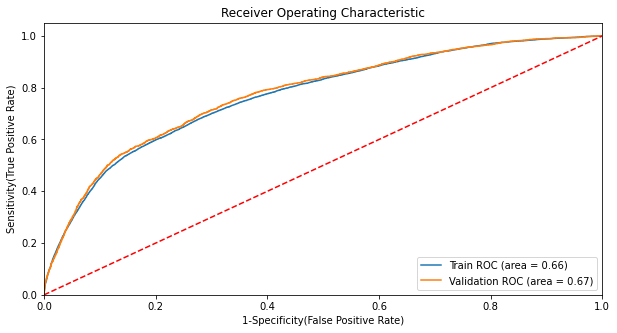

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.78      0.92      0.84     29695
           1       0.68      0.40      0.50     12790

    accuracy                           0.76     42485
   macro avg       0.73      0.66      0.67     42485
weighted avg       0.75      0.76      0.74     42485

[[27234  2461]
 [ 7652  5138]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.78      0.92      0.85      7424
           1       0.69      0.41      0.52      3198

    accuracy                           0.77     10622
   macro avg       0.74      0.67      0.68     10622
weighted avg       0.76      0.77      

In [45]:
NeuralNetwork = MLPClassifier(
    
    hidden_layer_sizes=8,
    activation='tanh',
    solver='sgd',
    alpha=0.001,
    learning_rate='constant',
    learning_rate_init=0.001,
    max_iter=100,
    random_state=None,
)

# -------------------------------------------------------------------------------------------
check_overfitting(data, target, random_state=0, scale_data=True, model=NeuralNetwork)

In [194]:
avg_score(data_selected, target, split_method=skf, scale_data=True, model=NeuralNetwork)

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



Average score of Train: 0.52484
Average score of Valid: 0.40733
Average of overfit: 0.11752


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:619: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


In [196]:
from sklearn.svm import SVC

### SVM

In [ ]:
scaler_svm = min_max2
model_svm = SVC()

param_svm = {'kernel': ['poly','linear','rbf','sigmoid'],
            'degree':[1,4],
            'gamma':['scale','auto'],
            'shrinking':[True,False],
            'class_weight':[None, 'balanced'],
            'verbose':[False, True],
            'max_iter':[-1,1,2],
            'decision_function_shape':['ovo','ovr']}

run_grid(data_selected, target, random_state=0, scale_data=True, model=model_svm, parameters=param_svm, scaler = scaler_svm)             

In [ ]:
SVM = SVC(
    kernel = 'linear',
    degree = 1,
    gamma = 'scale',
    shrinking = True,
    class_weight = 'balanced',
    verbose = False,
    max_iter = -1,
    decision_function_shape = 'ovo'
)

# check_overfitting(data_selected_features, target, random_state=100, remove_outliers=True, scale_data=True, model=SVC, scaler = scaler_svm)

In [ ]:
# avg_score(data, target, split_method=skf, remove_outliers=True, scale_data=True, model=SVM)

### Random Forest

In [ ]:
scaler_rf = min_max2
model_rf = RandomForestClassifier()

param_rf = {
    'n_estimators': [100,200,300],
  #  'bootstrap': [True,False],
    'max_samples': [0.6,0.8,None],
    'max_depth': [8,10],
  #  'max_features': [ 'sqrt','auto'],
    'criterion' :['gini', 'entropy'],
    
}

run_grid(data, target, random_state=0, scale_data=False, model=model_rf, parameters=param_rf)

Score of Train: 0.59038
Score of Valid: 0.58879
Difference between Train and Validation: 0.0016


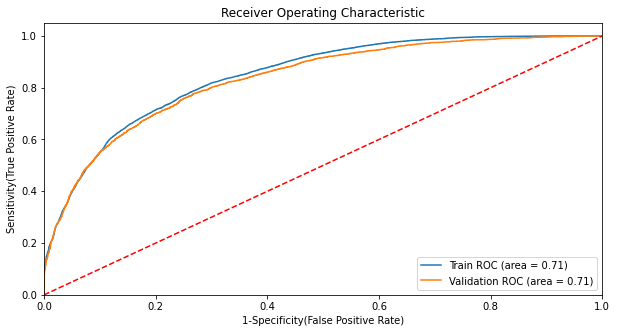

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.81      0.92      0.86     29695
           1       0.73      0.49      0.59     12790

    accuracy                           0.79     42485
   macro avg       0.77      0.71      0.73     42485
weighted avg       0.79      0.79      0.78     42485

[[27388  2307]
 [ 6467  6323]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.81      0.92      0.86      7424
           1       0.74      0.49      0.59      3198

    accuracy                           0.79     10622
   macro avg       0.77      0.71      0.73     10622
weighted avg       0.79      0.79      

In [47]:
Random_forest = RandomForestClassifier(
    bootstrap = False,
    criterion = 'gini',
    max_depth = 10,
    max_features = 'auto',
    max_samples = 0.6,
    n_estimators = 100,
)

# -------------------------------------------------------------------------------------------
check_overfitting(data, target, random_state=0, scale_data=False, model=Random_forest)

In [48]:
avg_score(data, target, split_method=skf, scale_data=False, model=Random_forest)


Average score of Train: 0.63962
Average score of Valid: 0.20526
Average of overfit: 0.43436


### Histogram Gradient Boosting

In [ ]:
    tscv = TimeSeriesSplit(n_splits=3, test_size=2, gap=2)
    for train_index, test_index in tscv.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

In [48]:
tscv = TimeSeriesSplit(n_splits=3, test_size=2, gap=2)
tscv

TimeSeriesSplit(gap=2, max_train_size=None, n_splits=3, test_size=2)

In [1]:
# for train_index, test_index in tscv.split(data):
#     print('TRAIN:', train_index, 'TEST:', test_index)
#     X_train, X_test = data[train_index], data[test_index]
#     y_train, y_test = y[train_index], y[test_index]

In [71]:
model_hgb = HistGradientBoostingClassifier()

param_hgb = {
#    'loss' : ['auto'],
    'learning_rate' : [0.3, 0.4],
    'min_samples_leaf' : [80, 90,100,200],
    'max_leaf_nodes': [11, 12,14, 15, 16],
#    'warm_start': [True],
#    'max_iter' : [70,100],
    'max_depth' : [6, 7,8,9, 10] 
}

run_grid(data, target, random_state=100, scale_data=False, model=model_hgb, parameters=param_hgb)

Best parameters= {'learning_rate': 0.3, 'max_depth': 9, 'max_leaf_nodes': 16, 'min_samples_leaf': 90}
Best score= 0.61872258817323


In [68]:
model_hgb = HistGradientBoostingClassifier()

param_hgb = {
#    'loss' : ['auto'],
    'learning_rate' : [0.3, 0.4],
    'min_samples_leaf' : [80, 90,100,200],
    'max_leaf_nodes': [11, 12,14, 15, 16],
#    'warm_start': [True],
#    'max_iter' : [70,100],
    'max_depth' : [6, 7,8,9, 10] 
}

run_grid(data_selected, target, random_state=100, scale_data=False, model=model_hgb, parameters=param_hgb)

Best parameters= {'learning_rate': 0.4, 'max_depth': 7, 'max_leaf_nodes': 14, 'min_samples_leaf': 200}
Best score= 0.6038306239857858


Score of Train: 0.63868
Score of Valid: 0.61115
Difference between Train and Validation: 0.02753


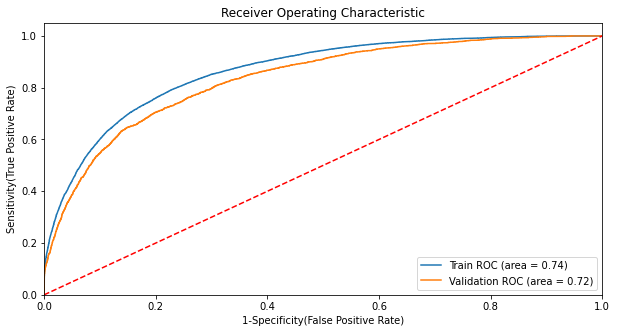

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.83      0.92      0.87     29695
           1       0.74      0.56      0.64     12790

    accuracy                           0.81     42485
   macro avg       0.79      0.74      0.75     42485
weighted avg       0.80      0.81      0.80     42485

[[27196  2499]
 [ 5617  7173]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.82      0.91      0.86      7424
           1       0.71      0.53      0.61      3198

    accuracy                           0.80     10622
   macro avg       0.77      0.72      0.74     10622
weighted avg       0.79      0.80      

In [73]:
HistogramGradBoost = HistGradientBoostingClassifier(
            random_state = None,
            learning_rate = 0.4,
            min_samples_leaf = 80,
            max_leaf_nodes = 16,
       #    warm_start = True,
       #     loss='auto',
       #     max_iter= 70,
            max_depth=7
        )

check_overfitting(data_selected, target, random_state=100, scale_data=False, model=HistogramGradBoost)

### Bagging Meta Classifier

In [76]:
from sklearn.ensemble import BaggingClassifier

In [77]:
scaler_b = min_max2
model_b = BaggingClassifier()

param_b = {
    'n_estimators': [20,80,100],
    'max_samples': [0.4,0.8,1.0],
    'max_features': [0.6,1.0],
    'bootstrap':[True, False],
#    'bootstrap_features':[True, False],
 #   'warm_start':[True,False],
    'verbose':[0,1]
}

run_grid(data, target, random_state=0, scale_data=True, model=model_b, parameters=param_b, scaler = min_max2)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Best parameters= {'bootstrap': False, 'max_features': 1.0, 'max_samples': 0.4, 'n_estimators': 100, 'verbose': 1}
Best score= 0.6174861412843786


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   39.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Score of Train: 0.0
Score of Valid: 0.0
Difference between Train and Validation: 0.0


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


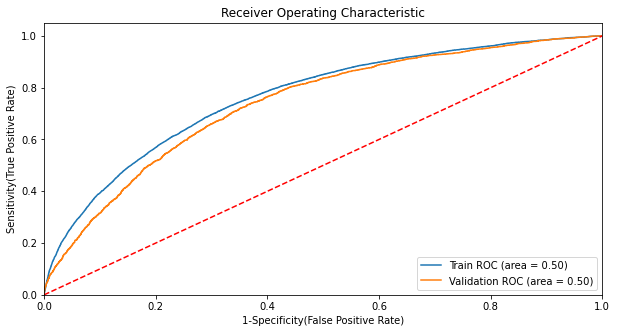

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.70      1.00      0.82     29695
           1       0.00      0.00      0.00     12790

    accuracy                           0.70     42485
   macro avg       0.35      0.50      0.41     42485
weighted avg       0.49      0.70      0.58     42485

[[29695     0]
 [12790     0]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.70      1.00      0.82      7424
           1       0.00      0.00      0.00      3198

    accuracy                           0.70     10622
   macro avg       0.35      0.50      0.41     10622
weighted avg       0.49      0.70      

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrador\anaconda

In [78]:
bagging = BaggingClassifier(
    n_estimators = 100,
    max_samples = 0.4,
    max_features = 1,
    bootstrap = False,
  #  bootstrap_features = False,
 #   warm_start = False,
    verbose = 1
)

check_overfitting(data, target, random_state=0, scale_data=True, model=bagging, scaler = scaler_b)

In [79]:
avg_score(data, target, split_method=skf, scale_data=True, model=bagging)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j


Average score of Train: 0.0
Average score of Valid: 0.0
Average of overfit: 0.0


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s finished


### Logistic Regression

In [81]:
scaler_lr = min_max2
model_lr = LogisticRegression()

param_lr = {
#     'penalty': ['l1'], 
#     'C': [3.5],
#     'max_iter': [300]
}

run_grid(data, target, random_state=0, scale_data=True, model=model_lr, parameters=param_lr, scaler = scaler_lr)

Best parameters= {}
Best score= 0.5210432042013302


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score of Train: 0.52608
Score of Valid: 0.53595
Difference between Train and Validation: -0.00987


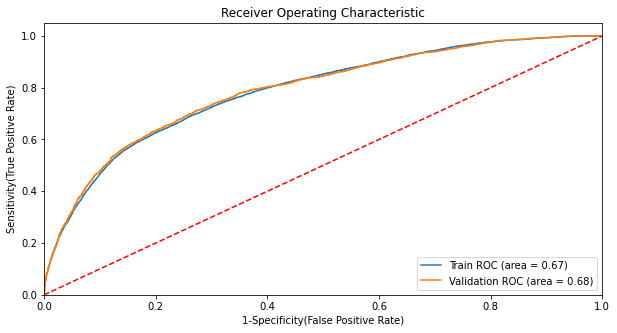

______________________________________________________
                        TRAIN                         
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.79      0.91      0.85     29695
           1       0.68      0.43      0.53     12790

    accuracy                           0.77     42485
   macro avg       0.74      0.67      0.69     42485
weighted avg       0.76      0.77      0.75     42485

[[27154  2541]
 [ 7318  5472]]

______________________________________________________
                      VALIDATION                      
------------------------------------------------------
              precision    recall  f1-score   support

           0       0.79      0.92      0.85      7424
           1       0.70      0.44      0.54      3198

    accuracy                           0.77     10622
   macro avg       0.74      0.68      0.69     10622
weighted avg       0.76      0.77      

In [85]:
lr = LogisticRegression(
#     penalty = , 
#     C = ,
#     max_iter = 300
)

check_overfitting(data, target, random_state=0, scale_data=True, model=model_lr, scaler = scaler_lr)

In [83]:
avg_score(data, target, split_method=skf, scale_data=True, model=model_lr)

C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regr


Average score of Train: 0.55243
Average score of Valid: 0.36466
Average of overfit: 0.18777


C:\Users\Administrador\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
